### Set up and Import

In [11]:
## Import required libraries
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from arch import arch_model
import warnings
warnings.filterwarnings("ignore")

### - 

### Procedure

#### ✨Step by Step Guide ✨
#### ① Analyze the original data and visualize it
#### ② Constructing Features
#### (NO SCALING FIRST) 🚩~~Sacling with a rowing window, preventing future data being seen ~~
#### ③ Performing ADF Test on the data and find the ideal p and q
#### ④ Apply Garhc model
#### ⑤ Analyze the model result

### -

### Read Data and Formatting

In [7]:
features = pd.read_csv(r"C:\Users\ps\PycharmProjects\pythonProject\Garch_feature_df.csv")
features.set_index(['tradingday'], inplace=True)

In [8]:
features

,C_Volume_1month,C_Turnover_1month,C_OpenInterest_1month,C_Volume_2month,C_Turnover_2month,C_OpenInterest_2month,C_Volume_1quarter,C_Turnover_1quarter,C_OpenInterest_1quarter,C_Volume_2quarter,...,Kurtosis_10D_due_1,Kurtosis_10D_due_2,Kurtosis_10D_due_3,Kurtosis_10D_due_4,ATMVOL_due_1,ATMVOL_due_2,ATMVOL_due_3,ATMVOL_due_4,next_ATMVOL_due_1,IV_return_due_1
tradingday,,,,,,,,,,,,,,,,,,,,,
2016-01-04,66383,33093135.0,145347,6460,3580664.0,10652,14986,14840193.00,75926,2236,...,1.012613,1.000000,1.004837,0.999150,0.305116,0.307941,0.326327,0.320228,0.312993,1.025818
2016-01-05,126907,58850594.0,163306,12616,8137192.0,14110,14932,11977096.00,76241,2519,...,1.025213,0.998040,1.049898,1.007366,0.312993,0.322863,0.318144,0.322979,0.294845,0.942019
2016-01-06,86468,40493942.0,166950,5220,3058123.0,15473,9470,13236434.00,78944,1115,...,1.032194,1.007750,1.036293,1.017606,0.294845,0.326976,0.313965,0.319394,0.344291,1.167701
2016-01-07,17171,6401139.0,168476,2473,1248189.0,16463,3217,2404845.00,79626,324,...,1.000000,1.000000,0.927339,0.949954,0.344291,0.299801,0.402996,0.311452,0.343662,0.998173
2016-01-08,130090,59087387.0,187378,23015,15454628.0,25046,19458,18549498.00,81790,3710,...,1.022564,0.988786,0.983888,0.993229,0.343662,0.373299,0.366315,0.365204,0.398614,1.159900
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-10,497569,213781953.0,740105,49638,23625695.0,90727,91193,26541099.32,181143,5845,...,1.003411,1.003733,1.004768,0.999100,0.146740,0.160837,0.167362,0.174463,0.143034,0.974740
2023-04-11,553012,221623779.0,765477,57252,27813556.0,103933,115456,31465546.29,187835,6717,...,0.999685,0.998667,1.001311,0.995983,0.143034,0.158107,0.165860,0.173785,0.140519,0.982420
2023-04-12,492159,168743102.0,801769,68584,27398765.0,118993,101765,27836232.50,193179,6233,...,1.000000,1.003290,0.999185,1.001947,0.140519,0.154520,0.163597,0.169858,0.135353,0.963237


### - 
### Date Visualization

In [12]:
%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
plt.figure(figsize=(10,5))
plt.grid(True)

# Convert the 'dates' to pandas datetime format
dates = pd.to_datetime(features.index)

gfg = sns.lineplot(x=dates, y='ATMVOL_due_1', data=features)
gfg.set_title( "Nearest Month ATM_VOL from 2016 till 2023 ")
gfg.set_xlabel( "Trading Month")
gfg.set_ylabel( "ATM_VOL")

# Get the current axis object
ax = plt.gca()

# Set the ticker to display only the year on the X-axis
ax.xaxis.set_major_locator(mdates.YearLocator())

# Set the number of desired X-axis tick labels
ax.xaxis.set_major_locator(mdates.YearLocator(8))

# Format the X-axis tick labels as year
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

# Rotate the X-axis tick labels for better visibility
plt.xticks(rotation=45)

plt.show

<IPython.core.display.Javascript object>

<function matplotlib.pyplot.show(block=None)>

In [13]:
%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
plt.figure(figsize=(10,5))
plt.grid(True)

# Convert the 'dates' to pandas datetime format
dates = pd.to_datetime(features.index)

gfg = sns.lineplot(x=dates, y='C_Volume_1month', data=features)
gfg.set_title( "Nearest Month Call_VOL from 2016 till 2023 ")
gfg.set_xlabel( "Trading Month")
gfg.set_ylabel( "Call_VOL")

# Get the current axis object
ax = plt.gca()

# Set the ticker to display only the year on the X-axis
ax.xaxis.set_major_locator(mdates.YearLocator())

# Set the number of desired X-axis tick labels
ax.xaxis.set_major_locator(mdates.YearLocator(8))

# Format the X-axis tick labels as year
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

# Rotate the X-axis tick labels for better visibility
plt.xticks(rotation=45)

plt.show

<IPython.core.display.Javascript object>

<function matplotlib.pyplot.show(block=None)>

<IPython.core.display.Javascript object>


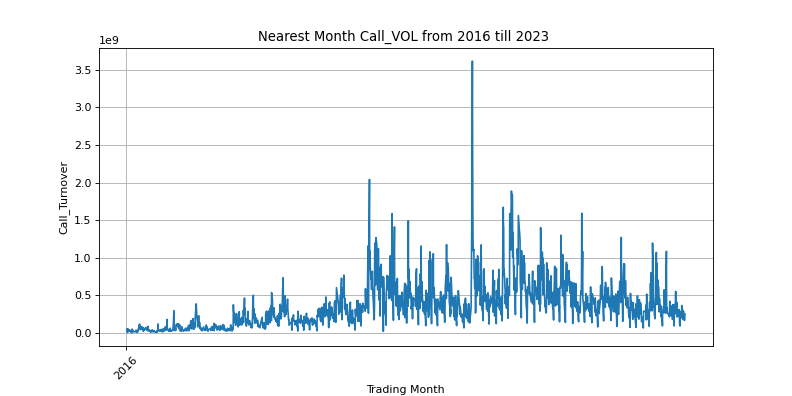

<function matplotlib.pyplot.show(block=None)>

In [14]:
%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
plt.figure(figsize=(10,5))
plt.grid(True)

# Convert the 'dates' to pandas datetime format
dates = pd.to_datetime(features.index)

gfg = sns.lineplot(x=dates, y='C_Turnover_1month', data=features)
gfg.set_title( "Nearest Month Call_VOL from 2016 till 2023 ")
gfg.set_xlabel( "Trading Month")
gfg.set_ylabel( "Call_Turnover")

# Get the current axis object
ax = plt.gca()

# Set the ticker to display only the year on the X-axis
ax.xaxis.set_major_locator(mdates.YearLocator())

# Set the number of desired X-axis tick labels
ax.xaxis.set_major_locator(mdates.YearLocator(8))

# Format the X-axis tick labels as year
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

# Rotate the X-axis tick labels for better visibility
plt.xticks(rotation=45)

plt.show

<IPython.core.display.Javascript object>


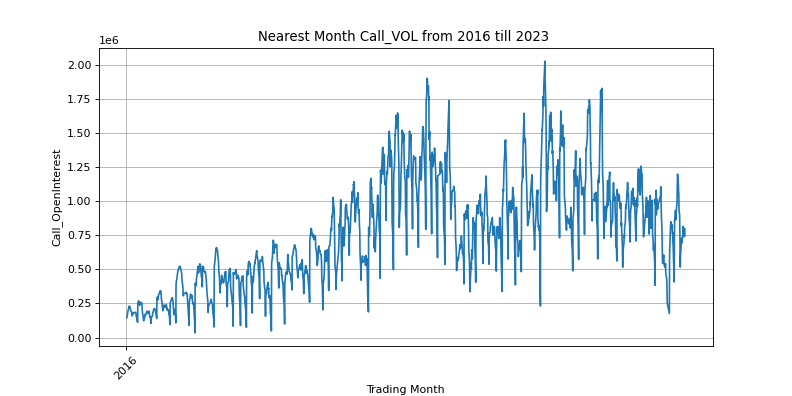

<function matplotlib.pyplot.show(block=None)>

In [15]:
%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
plt.figure(figsize=(10,5))
plt.grid(True)

# Convert the 'dates' to pandas datetime format
dates = pd.to_datetime(features.index)

gfg = sns.lineplot(x=dates, y='C_OpenInterest_1month', data=features)
gfg.set_title( "Nearest Month Call_VOL from 2016 till 2023 ")
gfg.set_xlabel( "Trading Month")
gfg.set_ylabel( "Call_OpenInterest")

# Get the current axis object
ax = plt.gca()

# Set the ticker to display only the year on the X-axis
ax.xaxis.set_major_locator(mdates.YearLocator())

# Set the number of desired X-axis tick labels
ax.xaxis.set_major_locator(mdates.YearLocator(8))

# Format the X-axis tick labels as year
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

# Rotate the X-axis tick labels for better visibility
plt.xticks(rotation=45)

plt.show

### Constructing Target Variable 

#### Let the target variable to be the sign of returns of the second day's option price  

In [16]:
# Apply the labeling based on the condition
features['label'] = features['IV_return_due_1'].apply(lambda x: 1 if x > 1 else 2)

In [17]:
# For the column label, 1 means the option price will rise the second day, 2 means the price will fall
features

,C_Volume_1month,C_Turnover_1month,C_OpenInterest_1month,C_Volume_2month,C_Turnover_2month,C_OpenInterest_2month,C_Volume_1quarter,C_Turnover_1quarter,C_OpenInterest_1quarter,C_Volume_2quarter,...,Kurtosis_10D_due_2,Kurtosis_10D_due_3,Kurtosis_10D_due_4,ATMVOL_due_1,ATMVOL_due_2,ATMVOL_due_3,ATMVOL_due_4,next_ATMVOL_due_1,IV_return_due_1,label
tradingday,,,,,,,,,,,,,,,,,,,,,
2016-01-04,66383,33093135.0,145347,6460,3580664.0,10652,14986,14840193.00,75926,2236,...,1.000000,1.004837,0.999150,0.305116,0.307941,0.326327,0.320228,0.312993,1.025818,1
2016-01-05,126907,58850594.0,163306,12616,8137192.0,14110,14932,11977096.00,76241,2519,...,0.998040,1.049898,1.007366,0.312993,0.322863,0.318144,0.322979,0.294845,0.942019,2
2016-01-06,86468,40493942.0,166950,5220,3058123.0,15473,9470,13236434.00,78944,1115,...,1.007750,1.036293,1.017606,0.294845,0.326976,0.313965,0.319394,0.344291,1.167701,1
2016-01-07,17171,6401139.0,168476,2473,1248189.0,16463,3217,2404845.00,79626,324,...,1.000000,0.927339,0.949954,0.344291,0.299801,0.402996,0.311452,0.343662,0.998173,2
2016-01-08,130090,59087387.0,187378,23015,15454628.0,25046,19458,18549498.00,81790,3710,...,0.988786,0.983888,0.993229,0.343662,0.373299,0.366315,0.365204,0.398614,1.159900,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-10,497569,213781953.0,740105,49638,23625695.0,90727,91193,26541099.32,181143,5845,...,1.003733,1.004768,0.999100,0.146740,0.160837,0.167362,0.174463,0.143034,0.974740,2
2023-04-11,553012,221623779.0,765477,57252,27813556.0,103933,115456,31465546.29,187835,6717,...,0.998667,1.001311,0.995983,0.143034,0.158107,0.165860,0.173785,0.140519,0.982420,2
2023-04-12,492159,168743102.0,801769,68584,27398765.0,118993,101765,27836232.50,193179,6233,...,1.003290,0.999185,1.001947,0.140519,0.154520,0.163597,0.169858,0.135353,0.963237,2


### -

## Concept Background

### MA, AR, ARMA, ARIMA


#### Correlation functions:
- <font color='purple'>ACF (Auto Correlation Function)</font>
    Auto Correlation function takes into consideration of all the past observations irrespective of its effect on the future or present time period. It calculates the correlation between the t and (t-k) time period. It includes all the lags or intervals between t and (t-k) time periods. Correlation is always calculated using the Pearson Correlation formula.
    
Consider an example of Cake distribution during my birthday. Let's assume that your mom asks you to bring pastries to the party. Every year you miss judging the no of invites to the party and end upbringing more or less no of cakes as per requirement. The difference in the actual and expected results in the error. So you want to avoid the error for this year hence we apply the moving average model on the time series and calculate the no of pastries needed this year based on past collective errors. Next, calculate the ACF values of all the lags in the time series. <font color='purple'>If the value of the ACF of any particular month is more than a significant value only those values will be considered for the model analysis.</font>



- <font color='blue'>PACF(Partial Correlation Function)</font>
    The PACF determines the partial correlation between time period t and t-k. It doesn’t take into consideration all the time lags between t and t-k. For e.g. let's assume that today's stock price may be dependent on 3 days prior stock price but it might not take into consideration yesterday's stock price closure. Hence we consider only the time lags having a direct impact on future time period by neglecting the insignificant time lags in between the two-time slots t and t-k.
    
Consider an example of a milk distribution company that produces milk every month in the country. We want to calculate the amount of milk to be produced current month considering the milk generated in the last year. We begin by calculating the PACF values of all the 12 lags with respect to the current month. If the value of the PACF of any particular month is more than a significant value only those values will be considered for the model analysis.<font color='blue'>This approach helps us filter out the noise or irrelevant lags and focus on the key periods that contribute significantly to the milk production patterns.</font> It allows for a more precise modeling and forecasting of the amount of milk to be produced in the current month based on the historical data.

More info see here: 
1) https://towardsdatascience.com/time-series-models-d9266f8ac7b0


2) https://towardsdatascience.com/advanced-time-series-analysis-with-arma-and-arima-a7d9b589ed6d


3) https://machinelearningmastery.com/gentle-introduction-autocorrelation-partial-autocorrelation/

#### Concepts:
-  <font color='purple'>MA(1)</font> models the current value of a time series variable is modeled as a linear combination of the current and previous random error terms. <font color='blue'>AR(1)</font> refers to an autoregressive model of order 1, which means it includes only one lagged term (the first term above the threshold). The model is based on the assumption that the current value of a time series variable is linearly related to its immediately preceding value. 

    In terms of interpretation, the <font color='purple'>MA(1)</font> model captures the immediate impact of past shocks or errors on the current value, while the <font color='blue'>AR(1)</font> model captures the persistence or memory effect of past values on the current value.
 _________________________________________________________________________________________________________________________________
    - Pure AR Models - Depends on the lagged values of the data you are modeling to make forecasts - p

    - Pure MA Models - Depends on the errors(residuals) of the previous forecasts you made to make current forecasts - q

    - Mixed Models ARMA - Takes into account both of the above factors when making predictions
 _______________________________________________________________________________________________________________________________   
    
    
 - <font color='red'>ARMA</font> (Autoregressive Moving Average) is a time series model that combines both autoregressive (AR) and moving average (MA) components. It is a popular model used to capture both the autoregressive and moving average behavior in a time series.
 
 An ARMA model of order (p, q) consists of two main components:
     1. <font color='blue'>Autoregressive (AR) Component</font>: The autoregressive component captures the linear relationship between the current value of a time series and its previous values. The "p" in AR(p) represents the order or number of lagged terms included in the model. Each lagged term is multiplied by a corresponding autoregressive coefficient.The autoregressive component can be represented as:

    X_t = c + ϕ_1 * X_{t-1} + ϕ_2 * X_{t-2} + ... + ϕ_p * X_{t-p} + ε_t
    
    where X_t is the variable of interest at time t, c is a constant term, ϕ_1, ϕ_2, ..., ϕ_p are the autoregressive coefficients, X_{t-1}, X_{t-2}, ..., X_{t-p} are the lagged values, and ε_t is the error term.

   2. <font color='blue'>Moving Average (MA) Component</font>: The moving average component captures the linear relationship between the current value of a time series and the error terms from previous time periods. The "q" in MA(q) represents the order or number of lagged error terms included in the model. Each lagged error term is multiplied by a corresponding moving average coefficient. The moving average component can be represented as:

    X_t = μ + ε_t + θ_1 * ε_{t-1} + θ_2 * ε_{t-2} + ... + θ_q * ε_{t-q}

    where X_t is the variable of interest at time t, μ is the mean or intercept term, ε_t is the error term at time t, θ_1, θ_2, ..., θ_q are the moving average coefficients, and ε_{t-1}, ε_{t-2}, ..., ε_{t-q} are the lagged error terms.
 ___________________________________________________________________________________________________________________________________
     
   The combination of autoregressive and moving average components allows <font color='red'>ARMA models</font> to capture both the short-term dependencies (autoregressive) and the impact of past shocks (moving average) on the current value of a time series.

   The selection of the appropriate order (p, q) for an ARMA model depends on the characteristics of the data and can be determined using statistical techniques such as model selection criteria (e.g., AIC, BIC) or diagnostic tests for model adequacy and residuals.

- <font color='orange'>ARIMA</font> includes an Integrated (I) component: This involves differencing the time series data to make it stationary. Differencing removes trends or seasonality in the data, making it easier to model.The incorporation of differencing in ARIMA allows it to handle non-stationary time series data, where the mean and variance change over time. By differencing the data, ARIMA can transform it into a stationary series, enabling the use of autoregressive and moving average components.

#### Questions to have in mind
- Conduct towards a classification problem or regular time series forcasting
- How to understand / capture / use volaitlity clustering? 
__________________________________________________________________________________________________________________

### - 

### GARCH
#### Notes:


Autoregressive: The current value can be expressed as a function of the previous values i.e. they are correlated.

Conditional: This informs that the variance is based on past errors.

Homoskedasticity: a situation where the the constant variability of errors across the levels of independent variables.

Heteroskedasticity: This implies the series displays unusual variance (varying variance).



#### Definitions:
- <font color='blue'>ARCH — Autoregressive Conditional Heteroskedasticity:</font> introduced by Robert F. Engle in 1982, focuses on capturing the conditional heteroscedasticity (varying volatility) in a time series. It assumes that the volatility of the series at a given time depends on the past squared residuals or errors. In other words, **the ARCH model captures the clustering or persistence of volatility in the data.** The ARCH model is specified as:

    σ²(t) = α₀ + α₁ε²(t-1) + α₂ε²(t-2) + ... + αₚε²(t-p)

    where σ²(t) represents the conditional variance at time t, ε(t) is the error term or residual at time t, and α₀, α₁, α₂, ..., αₚ are the ARCH parameters to be estimated. **However, it DO NOT model the change in variance over time.**



- <font color='blue'>GARCH — Generalized Autoregressive Conditional Heteroskedasticity: </font> introduced by Tim Bollerslev in 1986, extends the ARCH model by incorporating both past squared residuals and past conditional variances to model the volatility. It takes into account **the autoregressive behavior of volatility and the persistence of shocks (moving average)**. Thus GARCH is the “ARMA equivalent” of ARCH, which only has an autoregressive component.  The GARCH model is specified as:

    σ²(t) = ω + αε²(t-1) + βσ²(t-1)

    where σ²(t) represents the conditional variance at time t, ε(t) is the error term or residual at time t, ω is the constant term, α and β are the GARCH parameters to be estimated.

    The GARCH model allows for capturing both short-term and long-term volatility dynamics. The α parameter captures the impact of past squared residuals on current volatility, while the β parameter captures the impact of past conditional variances on current volatility.
_____________________________________________________________________________________________________________________________
    
#### Estimating ARCH/GARCH Models:



The estimation of ARCH/GARCH models involves finding the optimal values for the model parameters (α, β, and optionally ω) that best fit the data. This is typically done using maximum likelihood estimation (MLE) or other optimization techniques. Once the model parameters are estimated, the fitted model can be used for forecasting volatility, risk management, and other related applications.

ARCH and GARCH models have been widely used in financial econometrics to model and forecast the volatility of asset returns, which is essential for risk management, option pricing, and portfolio optimization. These models have also been extended and modified in various ways to accommodate specific characteristics of financial time series data, such as asymmetry, leverage effects, and fat-tailed distributions (e.g., EGARCH, GJR-GARCH).

It's worth noting that there are more advanced volatility models beyond ARCH and GARCH, such as stochastic volatility models and realized volatility models, which aim to capture additional features and complexities of volatility dynamics.


More info see here: 
1) https://medium.com/@ranjithkumar.rocking/time-series-model-s-arch-and-garch-2781a982b448


2) https://www.quantstart.com/articles/Generalised-Autoregressive-Conditional-Heteroskedasticity-GARCH-p-q-Models-for-Time-Series-Analysis/

### -

### Creating GARCH

#### Checking Data 

In [18]:
# Compute the number of duplicated rows
features.duplicated().sum()

0

In [19]:
# Counting the number of NaN for each column
features.isnull().sum().sort_values(ascending=False)

Skew_25D_due_4             10
ATMVOL_due_4               10
Kurtosis_10D_due_4         10
Skew_10D_due_4             10
Kurtosis_25D_due_4         10
                           ..
Volume_pcr_1quarter         0
Volume_pcr_2month           0
Volume_pcr_1month           0
P_OpenInterest_2quarter     0
label                       0
Length: 83, dtype: int64

In [20]:
# Counting the percentage of NaN for each column
features.isnull().sum().sort_values(ascending=False)/len(features) #NaN percentage for each column

Skew_25D_due_4             0.005647
ATMVOL_due_4               0.005647
Kurtosis_10D_due_4         0.005647
Skew_10D_due_4             0.005647
Kurtosis_25D_due_4         0.005647
                             ...   
Volume_pcr_1quarter        0.000000
Volume_pcr_2month          0.000000
Volume_pcr_1month          0.000000
P_OpenInterest_2quarter    0.000000
label                      0.000000
Length: 83, dtype: float64

#### Target Variable： next_ATMVOL_due_1

In [187]:
features.next_ATMVOL_due_1.isnull().sum()

1

In [188]:
# Percentage of missing values in  IV_return_due_1
(features.next_ATMVOL_due_1.isnull().sum()/len(features))

0.000564652738565782

In [189]:
# Find the index of NaN values in column 'IV_return_due_1'
nan_indices = features.index[pd.isnull(features['next_ATMVOL_due_1'])]
nan_indices

Index(['2019-02-22'], dtype='object', name='tradingday')

The options we have for dealing with missing values 👇

#### Option 1: Drop rows where Pesos value is missing
    data.dropna(subset=['Pesos']) 

#### Option 2: Replace missing Pesos values with mean
    data.Pesos.replace(np.nan, data.Pesos.mean()) 

#### Option 3: Replace missing Pesos values with linear interpolation.
_______________________________________________________________________________________________________________________________________

We here first attempt on Option 3 and see the result.

In [190]:
IV_1 = features.next_ATMVOL_due_1.copy()

In [116]:
def replace_missing_with_previous_two(data):
    # linear interpolate
    for i in range(len(data)):
        if pd.isna(data[i]):
            data[i] = data[i-1] + data[i-1] - data[i-2]
    
    return data

In [192]:
# Replace missing values with sum of previous two values
series_filled = replace_missing_with_previous_two(IV_1)

In [193]:
series_filled.isnull().sum()

0

<IPython.core.display.Javascript object>


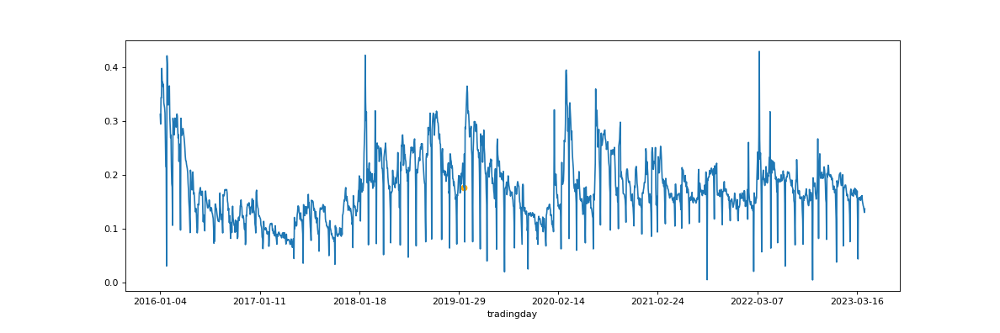

In [196]:
# Convert the Series to numeric data type
plt.figure(figsize=(15,5))
plt.grid(True)
series_filled.plot()

# Get the index positions of the two indices
index_positions = features.index.get_indexer(nan_indices)
# Color the specific values
plt.scatter(index_positions[0], series_filled[index_positions[0]], color='orange')
# plt.scatter(index_positions[1], series_filled[index_positions[1]], color='orange')


In [197]:
series_filled[index_positions[0]]

0.17704893182119572

We here conclude the interpolated value is normal given the range of volatility overtime


Thus, we are confident of procedding with Option 3.

In [198]:
features_filled = features.copy()
features_filled['next_ATMVOL_due_1'] = series_filled

In [199]:
features_filled['next_ATMVOL_due_1'].isnull().sum()

0

### Configuring Time Series

In [200]:
import  scipy.signal.signaltools

def _centered(arr, newsize):
    # Return the center newsize portion of the array.
    newsize = np.asarray(newsize)
    currsize = np.array(arr.shape)
    startind = (currsize - newsize) // 2
    endind = startind + newsize
    myslice = [slice(startind[k], endind[k]) for k in range(len(endind))]
    return arr[tuple(myslice)]

scipy.signal.signaltools._centered = _centered

In [201]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [202]:
# Convert index to DatetimeIndex
series_filled.index = pd.to_datetime(series_filled.index)

<IPython.core.display.Javascript object>


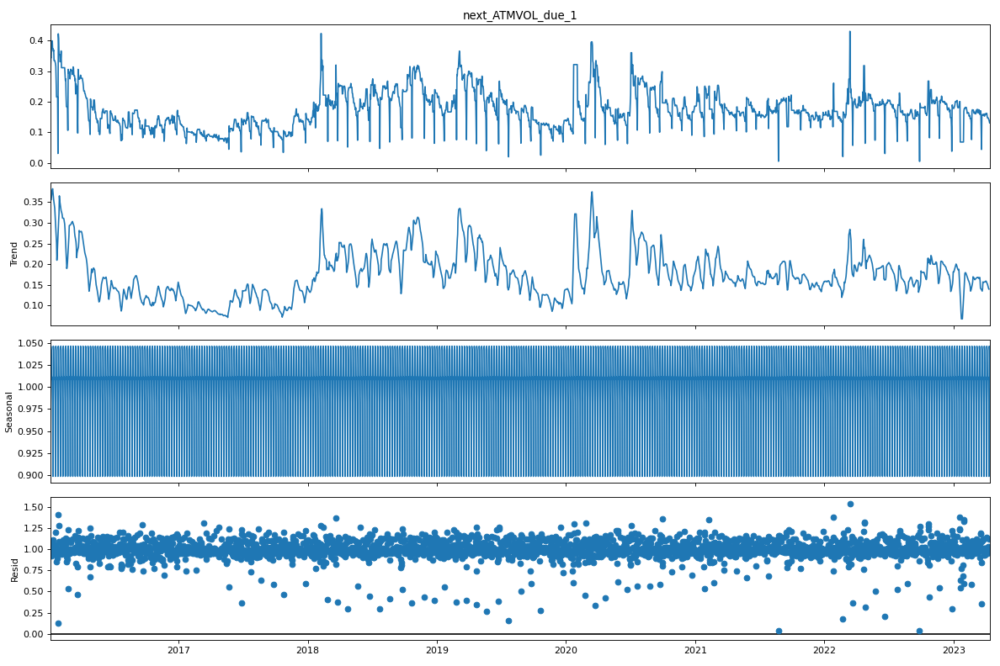

In [203]:
# Additive Decomposition (y = Trend + Seasonal + Residuals)
# Visualize the trend with forward filled
series_filled = series_filled.asfreq('D') 
series_filled = series_filled.ffill()
result_add = seasonal_decompose(series_filled, model='multiplicative')

# # Set the figure size
# plt.figure(figsize=(12, 8))

# Plot the decomposition
result_add.plot()

# Show the plot
plt.show()

In [204]:
## Redefine series_filled
series_filled = replace_missing_with_previous_two(IV_1)

In [205]:
def Int64Index(s, x):
    for i, v in enumerate(s):
        if v == x:
            return i
    return -1

#### Test for stationarity 

In [206]:
import statsmodels
from statsmodels.tsa.stattools import adfuller

In [207]:
def stationarity_test(X, cutoff=0.01):
    # H_0 in adfuller is unit root exists (non-stationary)
    # We must observe significant p-value to convince ourselves that the series is stationary
    pvalue = adfuller(X)[1]
    if pvalue < cutoff:
        print('p-value = ' + str(pvalue) + ' The series ' + X.name +' is likely stationary.')
    else:
        print('p-value = ' + str(pvalue) + ' The series ' + X.name +' is likely non-stationary.')

In [208]:
series_filled.isnull().sum()

0

In [209]:
stationarity_test(series_filled)

p-value = 0.00037441184771377185 The series next_ATMVOL_due_1 is likely stationary.


#### Test for correlation using <font color='blue'>ACF</font> and <font color='red'>PACF</font>

<IPython.core.display.Javascript object>


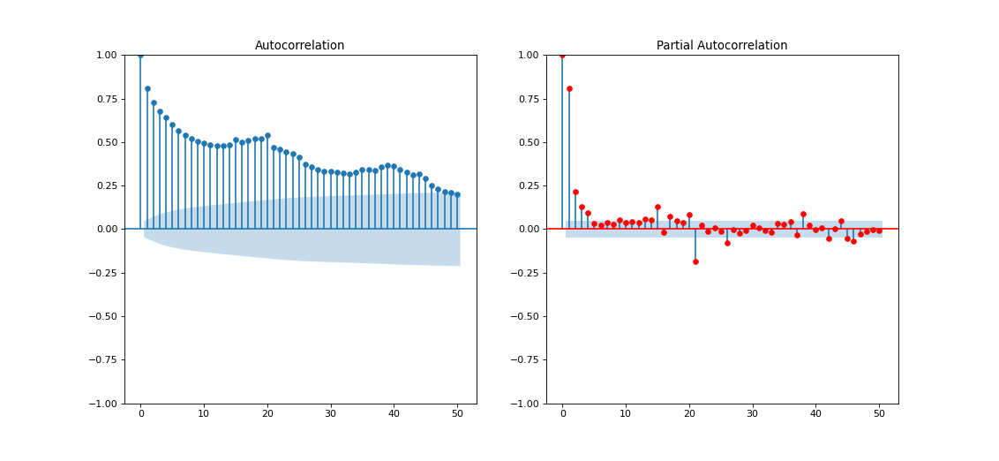

In [216]:
fig, axes = plt.subplots(1,2, figsize=(13,6))

plot_acf(series_filled, lags=50, ax=axes[0]);
plot_pacf(series_filled, lags=50, ax=axes[1], color='r');

#### <font color='red'>AR</font> (Auto regresssive processes)

<IPython.core.display.Javascript object>


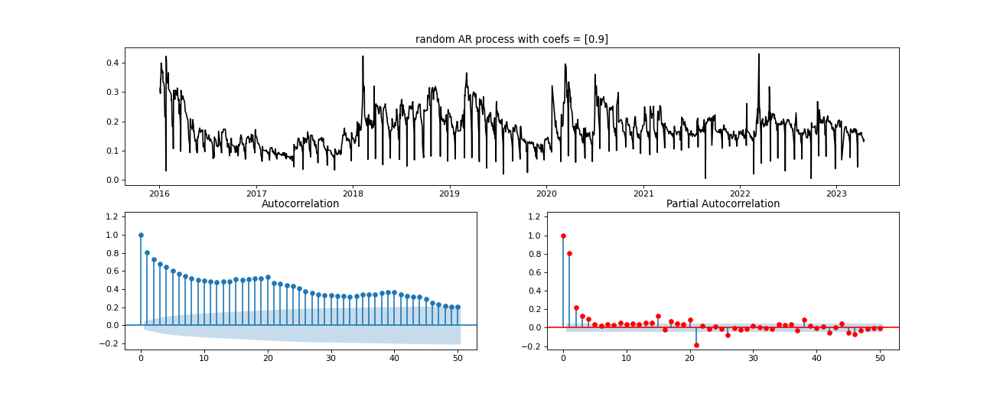

In [215]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa.arima_process import ArmaProcess
ar_terms = np.array([1, -0.9])
ma_terms = np.array([1])
ma_process = ArmaProcess(ar=ar_terms, ma=ma_terms)

fig = plt.figure(figsize=(15,6))
ax1 = fig.add_subplot(2,1,1)
ax1.set_title(f'random AR process with coefs = {-ar_terms[1:]}')
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,4)
ax1.plot(series_filled, color='black')
plot_acf(series_filled, lags=50, auto_ylims=True,ax=ax2);
plot_pacf(series_filled, lags=50, method='ywm', auto_ylims=True, ax=ax3, color='r');

 #### <font color='blue'>MA</font> (Moving Average processes)

<IPython.core.display.Javascript object>


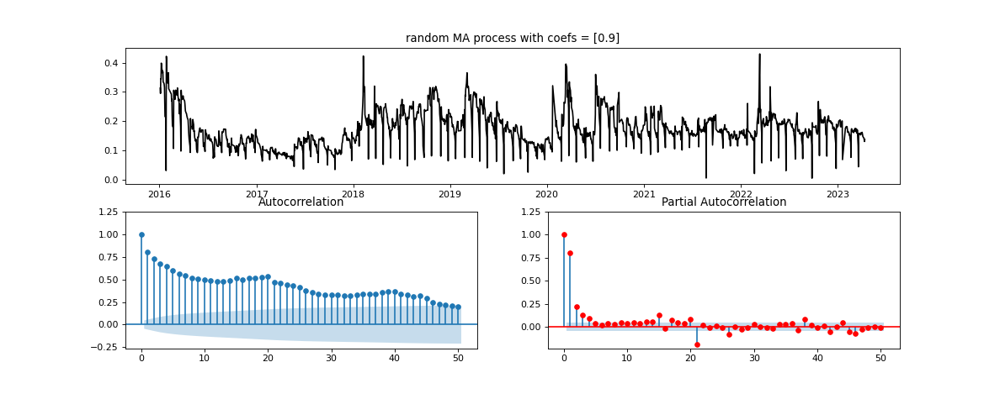

In [217]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa.arima_process import ArmaProcess
ar_terms = np.array([1])
ma_terms = np.array([1, 0.9])
ma_process = ArmaProcess(ar=ar_terms, ma=ma_terms)

fig = plt.figure(figsize=(15,6))
ax1 = fig.add_subplot(2,1,1)
ax1.set_title(f'random MA process with coefs = {ma_terms[1:]}')
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,4)
ax1.plot(series_filled, color='black')
plot_acf(series_filled, lags=50, auto_ylims=True,ax=ax2);
plot_pacf(series_filled, lags=50, method='ywm', auto_ylims=True, ax=ax3, color='r');

Therefore, we can confirm that our time series data is stationary.

<IPython.core.display.Javascript object>


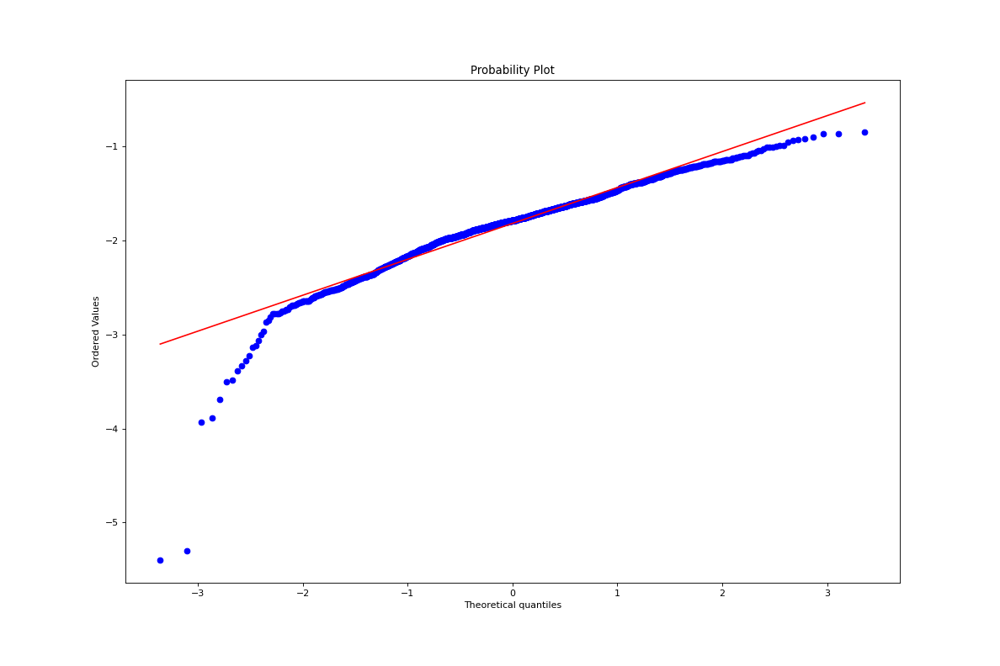

In [218]:
import scipy.stats as stats
%matplotlib notebook
stats.probplot(np.log(series_filled),dist='norm', plot=plt)
plt.show()

<IPython.core.display.Javascript object>


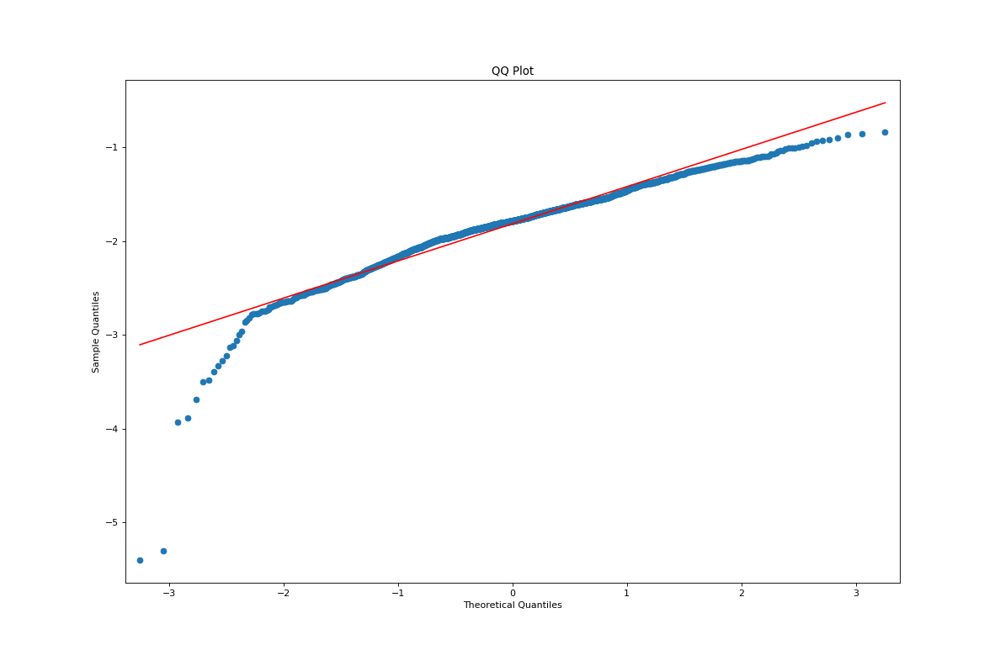

In [219]:
%matplotlib notebook
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt


# Create a QQ plot
fig = sm.qqplot(np.log(series_filled), line='s')

# Customize the plot
plt.title('QQ Plot')
plt.xlabel('Theoretical Quantiles')
plt.ylabel('Sample Quantiles')

# Display the plot
plt.show()

The above QQplot indicates data is too peaked in the middle


Source: https://towardsdatascience.com/q-q-plots-explained-5aa8495426c0

### GARCH Statistics

In [221]:
from arch import arch_model
model = arch_model(series_filled, p = 46, q = 21, dist = 't').fit(disp='off')
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                        Constant Mean - GARCH Model Results                         
====================================================================================
Dep. Variable:            next_ATMVOL_due_1   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                            GARCH   Log-Likelihood:                2574.43
Distribution:      Standardized Student's t   AIC:                          -5008.87
Method:                  Maximum Likelihood   BIC:                          -4625.32
                                              No. Observations:                 1771
Date:                      Wed, May 31 2023   Df Residuals:                     1770
Time:                              16:37:02   Df Model:                            1
                               Mean Model                               
========================================================================
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.1594  7.727e-03     20.634  1.351e-94 [  0.144,  0.175]
                              Volatility Model                              
============================================================================
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
omega      3.6916e-03  5.445e-04      6.780  1.203e-11 [2.624e-03,4.759e-03]
alpha[1]       0.3014      0.332      0.908      0.364     [ -0.349,  0.952]
alpha[2]   7.0464e-05      1.440  4.892e-05      1.000     [ -2.823,  2.823]
alpha[3]   5.6570e-05      3.445  1.642e-05      1.000     [ -6.753,  6.753]
alpha[4]   4.5799e-05      5.248  8.726e-06      1.000     [-10.287, 10.287]
alpha[5]   3.7524e-05      1.730  2.169e-05      1.000     [ -3.390,  3.390]
alpha[6]   3.7770e-05      2.270  1.664e-05      1.000     [ -4.450,  4.450]
alpha[7]   2.6977e-05      2.549  1.059e-05      1.000     [ -4.995,  4.995]
alpha[8]   2.7342e-05      3.883  7.041e-06      1.000     [ -7.611,  7.611]
alpha[9]   2.6067e-05      2.929  8.900e-06      1.000     [ -5.741,  5.741]
alpha[10]  2.4516e-05      1.277  1.920e-05      1.000     [ -2.502,  2.502]
alpha[11]  2.1934e-05      1.840  1.192e-05      1.000     [ -3.606,  3.606]
alpha[12]  2.2105e-05      2.851  7.753e-06      1.000     [ -5.588,  5.588]
alpha[13]  2.4549e-05      4.244  5.784e-06      1.000     [ -8.319,  8.319]
alpha[14]  2.7598e-05      0.927  2.977e-05      1.000     [ -1.817,  1.817]
alpha[15]  2.6156e-05      1.448  1.806e-05      1.000     [ -2.839,  2.839]
alpha[16]  2.3107e-05      6.341  3.644e-06      1.000     [-12.428, 12.428]
alpha[17]  2.3345e-05      2.612  8.938e-06      1.000     [ -5.119,  5.119]
alpha[18]  2.1589e-05      0.259  8.328e-05      1.000     [ -0.508,  0.508]
alpha[19]  2.1807e-05      4.629  4.710e-06      1.000     [ -9.073,  9.074]
alpha[20]  2.1689e-05      4.306  5.037e-06      1.000     [ -8.440,  8.440]
alpha[21]  2.1332e-05      2.459  8.674e-06      1.000     [ -4.820,  4.820]
alpha[22]  2.0895e-05      1.550  1.348e-05      1.000     [ -3.039,  3.039]
alpha[23]  2.0597e-05      0.908  2.268e-05      1.000     [ -1.780,  1.780]
alpha[24]  2.0160e-05      4.047  4.982e-06      1.000     [ -7.931,  7.931]
alpha[25]  2.1423e-05      2.274  9.420e-06      1.000     [ -4.458,  4.458]
alpha[26]  1.9899e-05      4.144  4.801e-06      1.000     [ -8.123,  8.123]
alpha[27]  1.9671e-05      1.284  1.532e-05      1.000     [ -2.517,  2.517]
alpha[28]  1.9674e-05      1.284  1.532e-05      1.000     [ -2.517,  2.517]
alpha[29]  2.0432e-05      0.198  1.034e-04      1.000     [ -0.387,  0.387]
alpha[30]  2.0676e-05      5.936  3.483e-06      1.000     [-11.635, 11.635]
alpha[31]  2.1042e-05      4.900  4.294e-0

In [222]:
# Specify GARCH model function
def garch_model(df, p=1, o=0, q=1, mean='constant', vol = 'GARCH', 
                dist='normal'):
    model = arch_model(
        df, 
        p = p, o=o, q = q, 
        mean = mean,
        vol = vol,
        dist = dist
    )
    return model

In [223]:
# Implement a basic GARCH model
basic_gm = garch_model(features_filled['next_ATMVOL_due_1']) 
# Fit the model
gm_result = basic_gm.fit(disp='off', show_warning=False)

# Display model fitting summary
print(gm_result.summary())

                     Constant Mean - GARCH Model Results                      
Dep. Variable:      next_ATMVOL_due_1   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                2853.04
Distribution:                  Normal   AIC:                          -5698.09
Method:            Maximum Likelihood   BIC:                          -5676.17
                                        No. Observations:                 1771
Date:                Wed, May 31 2023   Df Residuals:                     1770
Time:                        16:38:11   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.1585  1.605e-03     98.779      0.000 [  0.155,  0.16

In [224]:
# Obtain model estimated residuals and volatility
# Residual = predicted price - real price
gm_resid = gm_result.resid
# Predicted price volatility (std)
gm_std = gm_result.conditional_volatility

# Calculate the standardized residuals
gm_std_resid = gm_resid / gm_std

<IPython.core.display.Javascript object>


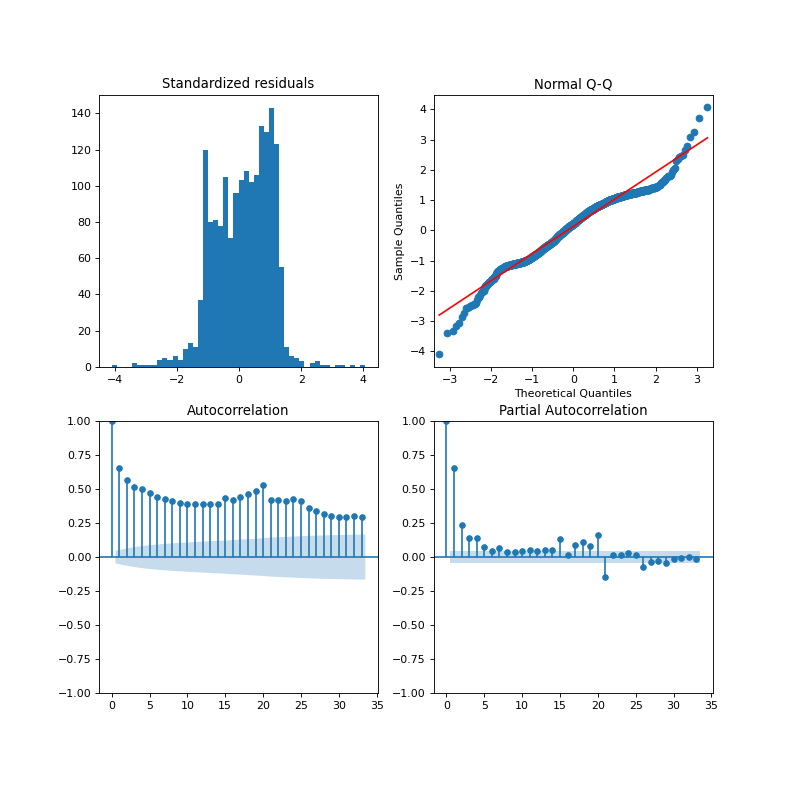

In [225]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.graphics.gofplots import qqplot

# Diagnose plot of residuals
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(10,10))
ax1.hist(gm_std_resid, bins = 50)
ax1.set_title('Standardized residuals')
qqplot(gm_std_resid, line='s', ax=ax2)
ax2.set_title('Normal Q-Q')
plot_acf(gm_std_resid, ax=ax3)
plot_pacf(gm_std_resid, ax=ax4)
plt.show()

In [226]:
# Specify GJR-GARCH model assumptions
gjr_gm = garch_model(features_filled['next_ATMVOL_due_1'], o=1, dist = 'skewt') 

# Fit the model
gjr_result = gjr_gm.fit(disp='off', show_warning=False)

# Get model estimated volatility
gjr_vol = gjr_result.conditional_volatility

In [230]:
series_filled

tradingday
2016-01-04    0.312993
2016-01-05    0.294845
2016-01-06    0.344291
2016-01-07    0.343662
2016-01-08    0.398614
                ...   
2023-04-10    0.143034
2023-04-11    0.140519
2023-04-12    0.135353
2023-04-13    0.130159
2023-04-14    0.137012
Name: next_ATMVOL_due_1, Length: 1771, dtype: float64

<IPython.core.display.Javascript object>


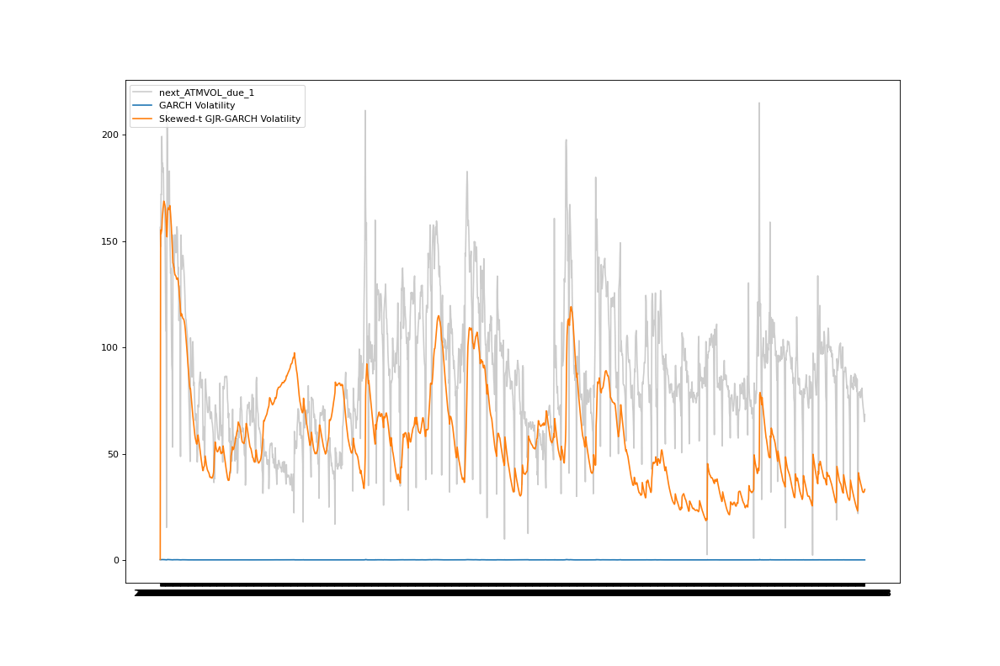

Correlation coef between GARCH & skewed-t GJR=GARCH: 0.69


In [232]:
%matplotlib notebook

# Plot model fitting results
plt.rc("figure", figsize=(15, 10))
gm_vol = gm_result.conditional_volatility
plt.plot(features_filled['next_ATMVOL_due_1']*500, color = 'grey', 
         label = 'next_ATMVOL_due_1', alpha = 0.4)
plt.plot(gm_vol, label = 'GARCH Volatility')
plt.plot(gjr_vol, label = 'Skewed-t GJR-GARCH Volatility')
plt.legend(loc = 'upper left')
plt.show()
print(f'Correlation coef between GARCH & skewed-t GJR=GARCH: {round(np.corrcoef(gm_vol, gjr_vol)[0,1],2)}')

#### Develop GARCH model

Developing an ARCH model involves three steps:

1. Iterate through combinations of ARIMA(p, d, q) models to best fit our time series.


2. Pick the GARCH model orders according to the ARIMA model with the lowest AIC.


3. Train_Test_Split



4. Fit the GARCH(p, q) model to our time series.


5. Examine the model residuals and squared residuals for autocorrelation.



In [382]:
# split into train/test
n_test = int(0.3 * len(series_filled))
train, test = series_filled[:-n_test], series_filled[-n_test:]

In [234]:
import pmdarima as pm

model = pm.auto_arima(
    train, 
    start_p=0, max_p=3,
    start_q=0, max_q=3, 
    d=None,           # let model determine 'd'
    test='adf',       # using adf test to find optimal 'd'
    trace=True, error_action='ignore',  suppress_warnings=True
)

print(model.summary())

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-3084.854, Time=0.06 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-4630.951, Time=0.08 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-3840.981, Time=0.10 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-621.963, Time=0.02 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-4695.041, Time=0.05 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-4706.148, Time=0.37 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-4708.369, Time=0.51 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-4727.889, Time=0.41 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-4713.300, Time=0.26 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-4717.355, Time=0.53 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-4718.765, Time=0.33 sec
 ARIMA(3,0,2)(0,0,0)[0] intercept   : AIC=-4730.728, Time=0.59 sec
 ARIMA(3,0,3)(0,0,0)[0] intercept   : AIC=-4716.372, Time=0.64 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=-4718.895, Time=0.61 sec
 ARIMA(3,0,2)(0,0,0)

Thus, the best (p,d,q) is (2, 0, 1) based on AIC Grid Search

In [357]:
# Specify GARCH model function
def garch_model(df, p=46, o=0, q=21, mean='zero', vol = 'GARCH', 
                dist='normal'):
    model = arch_model(
        df, 
        p = p, o=o, q = q, 
        mean = mean,
        vol = vol,
        dist = dist
    )
    return model

In [358]:
# Implement a basic GARCH model
basic_gm = garch_model(train) 
# Fit the model
gm_result = basic_gm.fit(disp='True', show_warning=False)

# Display model fitting summary
print(gm_result.summary())

Iteration:      1,   Func. Count:     70,   Neg. LLF: -198.38114693690926
Iteration:      2,   Func. Count:    140,   Neg. LLF: 605345117.3604486
Iteration:      3,   Func. Count:    211,   Neg. LLF: -198.9677788507176
Iteration:      4,   Func. Count:    281,   Neg. LLF: -226.45801402480333
Iteration:      5,   Func. Count:    351,   Neg. LLF: -367.8562237261234
Iteration:      6,   Func. Count:    421,   Neg. LLF: -443.94595743297435
Iteration:      7,   Func. Count:    491,   Neg. LLF: -451.6861723684282
Iteration:      8,   Func. Count:    561,   Neg. LLF: -450.77373428939114
Iteration:      9,   Func. Count:    631,   Neg. LLF: -448.94474087177935
Iteration:     10,   Func. Count:    701,   Neg. LLF: -451.26278174392337
Iteration:     11,   Func. Count:    771,   Neg. LLF: -452.6374923747404
Iteration:     12,   Func. Count:    841,   Neg. LLF: -450.79912030822936
Iteration:     13,   Func. Count:    911,   Neg. LLF: -454.4145418490255
Iteration:     14,   Func. Count:    980,   N

In [359]:
# Get the predicted variance, omega, alpha, and beta
omega = gm_result.params['omega']
alpha = gm_result.params['alpha[1]']
beta = gm_result.params['beta[1]']

In [360]:
# Convert predicted variance to standard deviation
predicted_std = np.sqrt(omega)

# Use the predicted standard deviation for further calculations
# For example, compute upper and lower bounds for a confidence interval
confidence_interval = (predicted_std * 1.96, predicted_std * -1.96)
print("Confidence Interval:", confidence_interval)

persistence = alpha + beta
print("Volatility Persistence:", persistence)

Confidence Interval: (0.04768920225359818, -0.04768920225359818)
Volatility Persistence: 0.4440400449733993


In [361]:
# forecast the test set
yhat = gm_result.forecast(horizon=n_test)
pred = yhat.variance.values[-1, :]

In [362]:
df = pd.DataFrame()
df["test_data"] = test
df['pred_data'] = np.sqrt(pred)

<IPython.core.display.Javascript object>


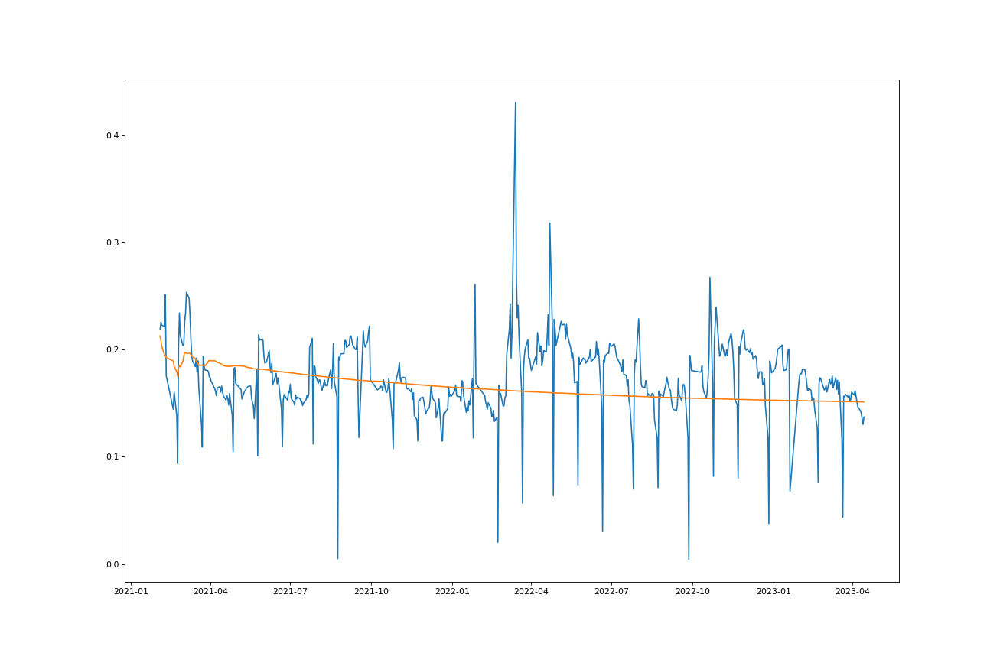

In [369]:
%matplotlib notebook
# plot the actual return
plt.plot(df["test_data"])
# plot forecast return
plt.plot(df['pred_data'])
plt.show()

1) eliminate extreme value / when the data is at due date


2) Use a rolling window

### Deal with Outliers

<IPython.core.display.Javascript object>


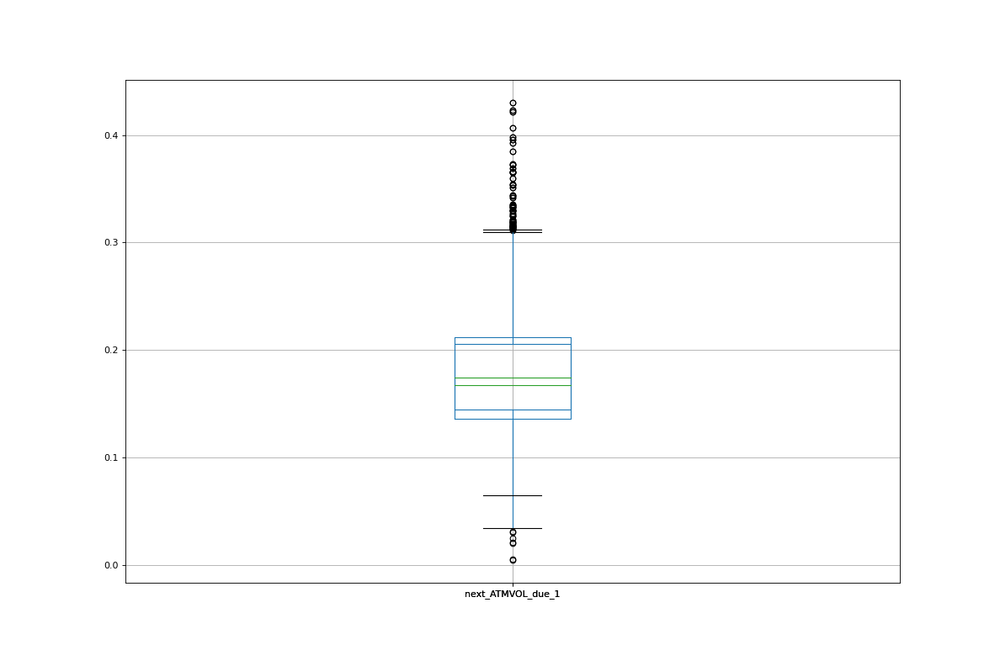

In [371]:
%matplotlib notebook
features_filled[['next_ATMVOL_due_1']].boxplot()
plt.show()

In [419]:
# No expiry date data
df = pd.read_csv(r"C:\Users\ps\PycharmProjects\pythonProject\feature_df.csv")
df = df.iloc[:-1,:]

In [421]:
for i in range(len(df)):
    df.iloc[i,0] = str(df.iloc[i,0])[2:4] + '-'+str(df.iloc[i,0])[4:6] + '-'+ str(df.iloc[i,0])[6:]

In [424]:
df['target_date'] = pd.to_datetime(df['target_date'], format="%Y-%m-%d")

In [427]:
df = df.set_index(df['target_date'])
df.drop(['target_date'], axis=1)

,Skew_25D_due_1,Skew_25D_due_2,Skew_25D_due_3,Skew_25D_due_4,Skew_10D_due_1,Skew_10D_due_2,Skew_10D_due_3,Skew_10D_due_4,Kurtosis_25D_due_1,Kurtosis_25D_due_2,...,Kurtosis_10D_due_1,Kurtosis_10D_due_2,Kurtosis_10D_due_3,Kurtosis_10D_due_4,ATMVOL_due_1,ATMVOL_due_2,ATMVOL_due_3,ATMVOL_due_4,next_ATMVOL_due_1,IV_return_due_1
target_date,,,,,,,,,,,,,,,,,,,,,
2015-12-24,0.946528,0.964451,0.979625,0.791004,0.956374,0.991278,0.993940,0.953796,1.053794,1.030190,...,1.016445,1.005393,1.007347,0.984591,0.251388,0.274539,0.304154,0.337364,0.243904,0.970228
2015-12-25,0.911996,0.975455,1.002535,0.953451,0.923177,0.983433,1.025264,0.963747,1.066176,1.006449,...,1.014153,1.000190,1.023074,0.975556,0.243904,0.273826,0.296876,0.332105,0.247536,1.014890
2015-12-28,0.884039,0.989217,0.977792,0.933887,0.972485,1.009575,0.994483,0.976142,1.036670,1.056656,...,1.007951,1.015533,0.995923,1.011400,0.247536,0.281861,0.304278,0.328334,0.242448,0.979447
2015-12-29,0.883791,0.942204,0.986722,0.897066,0.955404,0.980995,0.980241,0.966051,1.045626,1.047302,...,1.012868,1.006243,0.998659,0.992049,0.242448,0.283527,0.304629,0.332374,0.247040,1.018939
2015-12-30,0.884231,0.920435,0.990077,0.877654,0.951369,0.981544,1.005455,0.970209,1.046403,1.031372,...,1.008643,1.008753,0.991520,0.992499,0.247040,0.282583,0.305781,0.329847,0.256422,1.037979
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-06,1.022014,1.017788,0.999960,1.005222,1.023026,1.015247,1.005050,0.988009,1.002014,1.014630,...,1.000944,1.007092,1.000313,0.992752,0.161652,0.167877,0.172263,0.178170,0.151567,0.937610
2023-04-07,1.023743,1.036903,0.988937,1.001649,1.010624,1.013452,1.000846,0.994119,1.019071,1.027883,...,1.002466,1.001801,1.006544,1.004853,0.151567,0.162653,0.169434,0.175875,0.146740,0.968156
2023-04-10,1.010691,1.011729,1.000068,1.012234,1.000555,1.016480,0.992200,1.001564,1.018069,1.007341,...,1.003411,1.003733,1.004768,0.999100,0.146740,0.160837,0.167362,0.174463,0.143034,0.974740


In [444]:
features_filled.index = pd.to_datetime(features_filled.index, format="%Y-%m-%d")

In [445]:
# Find the different index between df1 and df2
diff_index = features_filled.index.difference(df.index)

In [448]:
cleaned_features = features_filled.drop(diff_index)
cleaned_features

,C_Volume_1month,C_Turnover_1month,C_OpenInterest_1month,C_Volume_2month,C_Turnover_2month,C_OpenInterest_2month,C_Volume_1quarter,C_Turnover_1quarter,C_OpenInterest_1quarter,C_Volume_2quarter,...,Kurtosis_10D_due_2,Kurtosis_10D_due_3,Kurtosis_10D_due_4,ATMVOL_due_1,ATMVOL_due_2,ATMVOL_due_3,ATMVOL_due_4,next_ATMVOL_due_1,IV_return_due_1,label
tradingday,,,,,,,,,,,,,,,,,,,,,
2016-01-04,66383,33093135.0,145347,6460,3580664.0,10652,14986,14840193.00,75926,2236,...,1.000000,1.004837,0.999150,0.305116,0.307941,0.326327,0.320228,0.312993,1.025818,1
2016-01-05,126907,58850594.0,163306,12616,8137192.0,14110,14932,11977096.00,76241,2519,...,0.998040,1.049898,1.007366,0.312993,0.322863,0.318144,0.322979,0.294845,0.942019,2
2016-01-06,86468,40493942.0,166950,5220,3058123.0,15473,9470,13236434.00,78944,1115,...,1.007750,1.036293,1.017606,0.294845,0.326976,0.313965,0.319394,0.344291,1.167701,1
2016-01-07,17171,6401139.0,168476,2473,1248189.0,16463,3217,2404845.00,79626,324,...,1.000000,0.927339,0.949954,0.344291,0.299801,0.402996,0.311452,0.343662,0.998173,2
2016-01-08,130090,59087387.0,187378,23015,15454628.0,25046,19458,18549498.00,81790,3710,...,0.988786,0.983888,0.993229,0.343662,0.373299,0.366315,0.365204,0.398614,1.159900,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-06,396728,179073716.0,816754,29657,14043725.0,72216,56116,16294061.84,182433,6131,...,1.007092,1.000313,0.992752,0.161652,0.167877,0.172263,0.178170,0.151567,0.937610,2
2023-04-07,654883,289716207.0,749861,54384,26612692.0,81297,94526,30775035.44,182910,5958,...,1.001801,1.006544,1.004853,0.151567,0.162653,0.169434,0.175875,0.146740,0.968156,2
2023-04-10,497569,213781953.0,740105,49638,23625695.0,90727,91193,26541099.32,181143,5845,...,1.003733,1.004768,0.999100,0.146740,0.160837,0.167362,0.174463,0.143034,0.974740,2


<IPython.core.display.Javascript object>


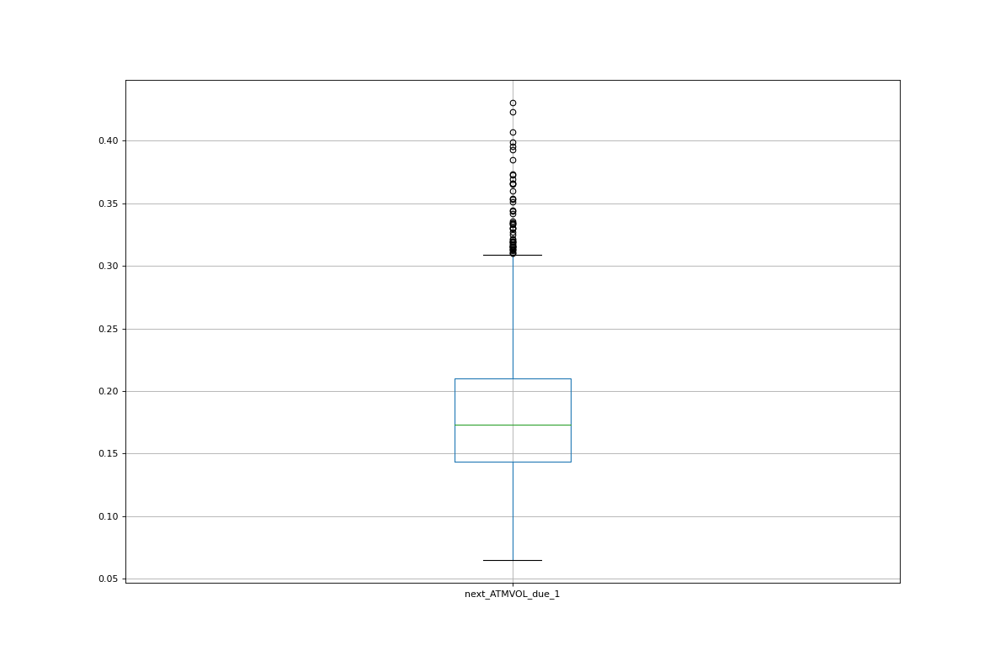

In [449]:
%matplotlib notebook
cleaned_features[['next_ATMVOL_due_1']].boxplot()
plt.show()

<IPython.core.display.Javascript object>


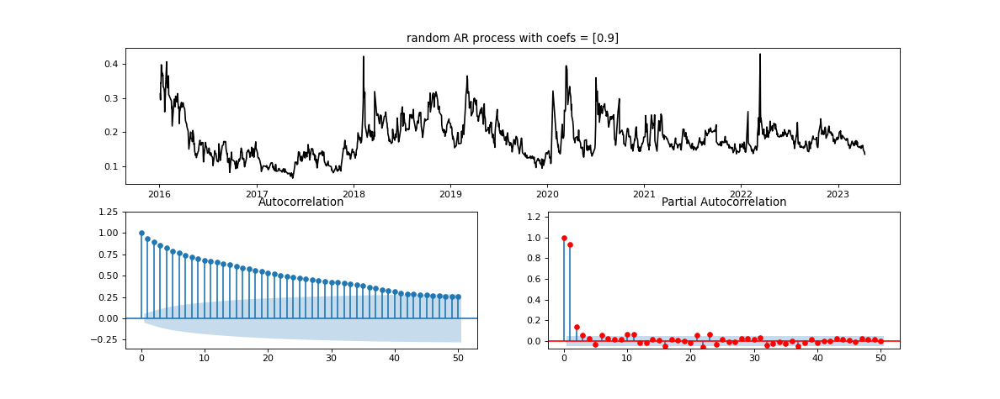

In [451]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa.arima_process import ArmaProcess
ar_terms = np.array([1, -0.9])
ma_terms = np.array([1])
ma_process = ArmaProcess(ar=ar_terms, ma=ma_terms)

fig = plt.figure(figsize=(15,6))
ax1 = fig.add_subplot(2,1,1)
ax1.set_title(f'random AR process with coefs = {-ar_terms[1:]}')
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,4)
ax1.plot(cleaned_features['next_ATMVOL_due_1'], color='black')
plot_acf(cleaned_features['next_ATMVOL_due_1'], lags=50, auto_ylims=True,ax=ax2);
plot_pacf(cleaned_features['next_ATMVOL_due_1'], lags=50, method='ywm', auto_ylims=True, ax=ax3, color='r');

In [452]:
# split into train/test
n_test1 = int(0.3 * len(cleaned_features['next_ATMVOL_due_1']))
train1, test1 = cleaned_features['next_ATMVOL_due_1'][:-n_test], cleaned_features['next_ATMVOL_due_1'][-n_test:]

In [453]:
model = pm.auto_arima(
    train1, 
    start_p=0, max_p=3,
    start_q=0, max_q=3, 
    d=None,           # let model determine 'd'
    test='adf',       # using adf test to find optimal 'd'
    trace=True, error_action='ignore',  suppress_warnings=True
)

print(model.summary())

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-2214.324, Time=0.05 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-4342.126, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-3050.984, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-385.449, Time=0.02 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-4361.634, Time=0.04 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-4362.184, Time=0.14 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-4359.483, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-4361.614, Time=0.18 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.06 sec

Best model:  ARIMA(3,0,0)(0,0,0)[0] intercept
Total fit time: 0.653 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  890
Model:               SARIMAX(3, 0, 0)   Log Likelihood                2186.092
Date:                Wed, 31 May 2023   AIC    

In [454]:
# Implement a basic GARCH model
basic_gm = garch_model(train) 
# Fit the model
gm_result = basic_gm.fit(disp='True', show_warning=False)

# Display model fitting summary
print(gm_result.summary())

Iteration:      1,   Func. Count:     70,   Neg. LLF: -198.38114693690926
Iteration:      2,   Func. Count:    140,   Neg. LLF: 605345117.3604486
Iteration:      3,   Func. Count:    211,   Neg. LLF: -198.9677788507176
Iteration:      4,   Func. Count:    281,   Neg. LLF: -226.45801402480333
Iteration:      5,   Func. Count:    351,   Neg. LLF: -367.8562237261234
Iteration:      6,   Func. Count:    421,   Neg. LLF: -443.94595743297435
Iteration:      7,   Func. Count:    491,   Neg. LLF: -451.6861723684282
Iteration:      8,   Func. Count:    561,   Neg. LLF: -450.77373428939114
Iteration:      9,   Func. Count:    631,   Neg. LLF: -448.94474087177935
Iteration:     10,   Func. Count:    701,   Neg. LLF: -451.26278174392337
Iteration:     11,   Func. Count:    771,   Neg. LLF: -452.6374923747404
Iteration:     12,   Func. Count:    841,   Neg. LLF: -450.79912030822936
Iteration:     13,   Func. Count:    911,   Neg. LLF: -454.4145418490255
Iteration:     14,   Func. Count:    980,   N

In [456]:
# forecast the test set
yhat = gm_result.forecast(horizon=n_test)
pred = yhat.variance.values[-1, :]

In [457]:
result = pd.DataFrame()
result["test_data"] = test
result['pred_data'] = np.sqrt(pred)

<IPython.core.display.Javascript object>


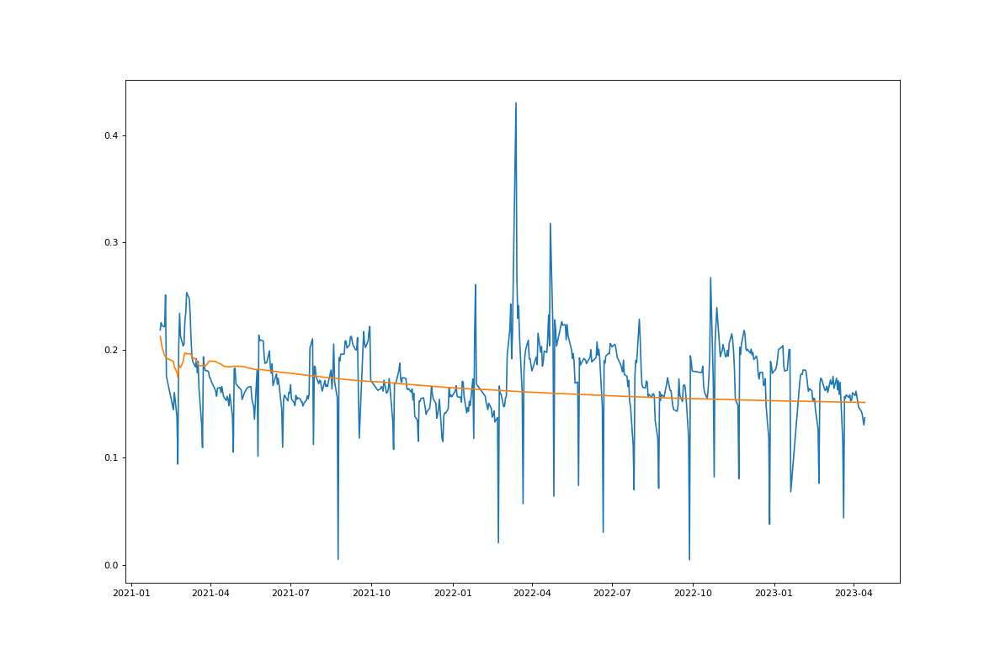

In [458]:
%matplotlib notebook
# plot the actual return
plt.plot(result["test_data"])
# plot forecast return
plt.plot(result['pred_data'])
plt.show()

### Rolling Windows

In [549]:
window_size = 5
n_periods = len(train) - window_size + 1
y_pred = []

for i in range(n_periods):
    # Extract the current window of data
    window = train[i:i+window_size]
    
    # Fit the GARCH model on the window
    model = garch_model(window) 
    model_fit = model.fit(disp='True', show_warning=False)
    y_pred.append(model_fit.forecast(horizon=1).variance.values[-1, 0])
    print(y_pred)
    
    # Print the parameters or do further analysis
    print(f"Parameters for Window {i+1}:")

Iteration:      1,   Func. Count:     70,   Neg. LLF: 3.4782306994021317
Iteration:      2,   Func. Count:    142,   Neg. LLF: 1.7103793710779043
Iteration:      3,   Func. Count:    211,   Neg. LLF: 1.7084159540482582
Iteration:      4,   Func. Count:    280,   Neg. LLF: 1.7048518920396762
Iteration:      5,   Func. Count:    349,   Neg. LLF: 1.7042236278258853
Iteration:      6,   Func. Count:    418,   Neg. LLF: 1.7036433146082488
Iteration:      7,   Func. Count:    487,   Neg. LLF: 1.7034857553625227
Iteration:      8,   Func. Count:    556,   Neg. LLF: 1.7027536313709342
Iteration:      9,   Func. Count:    625,   Neg. LLF: 1.702296016593343
Iteration:     10,   Func. Count:    694,   Neg. LLF: 1.7020537984312463
Iteration:     11,   Func. Count:    763,   Neg. LLF: 1.701670890717278
Iteration:     12,   Func. Count:    832,   Neg. LLF: 1.7016342175403345
Iteration:     13,   Func. Count:    901,   Neg. LLF: 1.7014701399518284
Iteration:     14,   Func. Count:    970,   Neg. LLF:

In [553]:
y_pred = y_pred[:n_test]
len(y_pred), n_test 

(531, 531)

In [547]:
yhat.variance.values[-1, 0]

0.04253855486587047

In [541]:
# forecast the test set
yhat = model_fit.forecast(horizon=n_test)
pred = yhat.variance.values[-1, :]

In [542]:
result = pd.DataFrame()
result["test_data"] = test
result['pred_data'] = np.sqrt(pred)

<IPython.core.display.Javascript object>


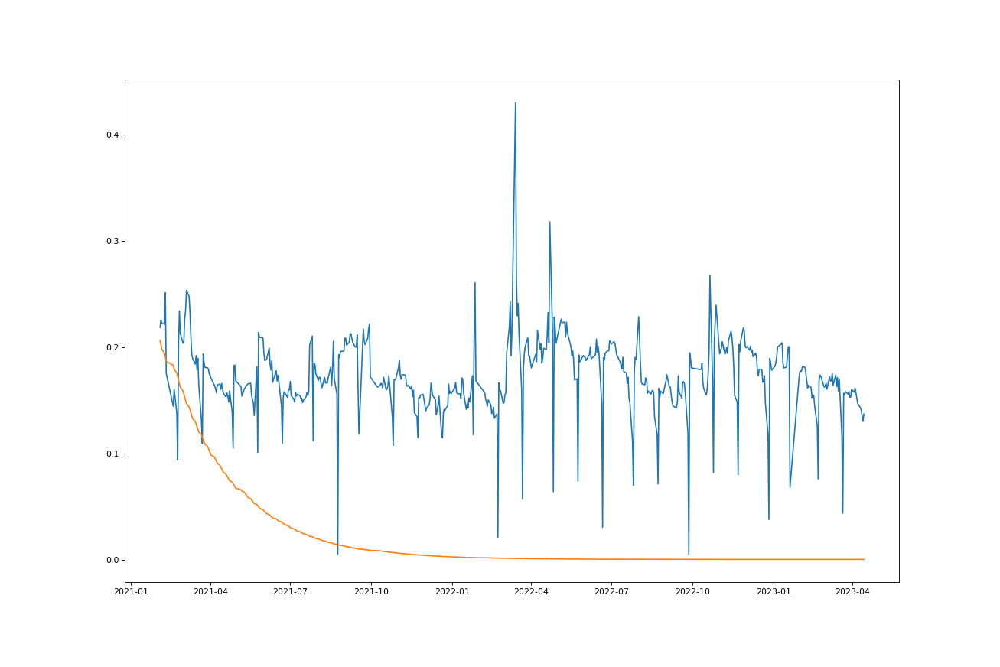

In [543]:
%matplotlib notebook
# plot the actual return
plt.plot(result["test_data"])
# plot forecast return
plt.plot(result['pred_data'])
plt.show()

### ARIMA Fit with expanding windows

In [524]:
# Expanding Window with new real results adding into the sample each time
from statsmodels.tsa.arima.model import ARIMA

train_arima = train1.dropna()
test_arima = test1.dropna()
history = [x for x in train_arima]
y = test_arima
predictions = list()
model = ARIMA(history, order=(2,1,2))
model_fit = model.fit()
yhat = model_fit.forecast()[0]
predictions.append(yhat)
history.append(y[0])
for i in range(1, len(y)):
    model = ARIMA(history, order=(3,0,2))
    model_fit = model.fit()
    print(model_fit.forecast())
    yhat = model_fit.forecast()[0]
    predictions.append(yhat)
    obs = y[i]
    history.append(obs)

[0.25296618]
[0.25852713]
[0.2623031]
[0.27185517]
[0.27188234]
[0.27322361]
[0.27674882]
[0.27996095]
[0.26812855]
[0.26385273]
[0.25807235]
[0.24793371]
[0.24901176]
[0.24591951]
[0.25747116]
[0.24980786]
[0.23467004]
[0.22365066]
[0.21628411]
[0.24130688]
[0.23802246]
[0.23673812]
[0.24423537]
[0.24315506]
[0.2448611]
[0.24466032]
[0.23775489]
[0.24836727]
[0.23106145]
[0.21419713]
[0.18609814]
[0.17440257]
[0.16401124]
[0.16528033]
[0.17545873]
[0.24275985]
[0.25916982]
[0.28370593]
[0.29272999]
[0.1858363]
[0.20642405]
[0.20180389]
[0.19393036]
[0.19168764]
[0.18821747]
[0.17009399]
[0.16573899]
[0.16620723]
[0.16546553]
[0.16168109]
[0.20181732]
[0.20869525]
[0.208582]
[0.19780987]
[0.1903269]
[0.18652826]
[0.18871807]
[0.18897578]
[0.1834079]
[0.17806232]
[0.1647541]
[0.15580039]
[0.15421178]
[0.16144317]
[0.16436011]
[0.1491351]
[0.17417786]
[0.17754538]
[0.20346172]
[0.21173624]
[0.21401005]
[0.20473212]
[0.18768842]
[0.18113074]
[0.16821868]
[0.15773935]
[0.15949692]
[0.14965

<IPython.core.display.Javascript object>


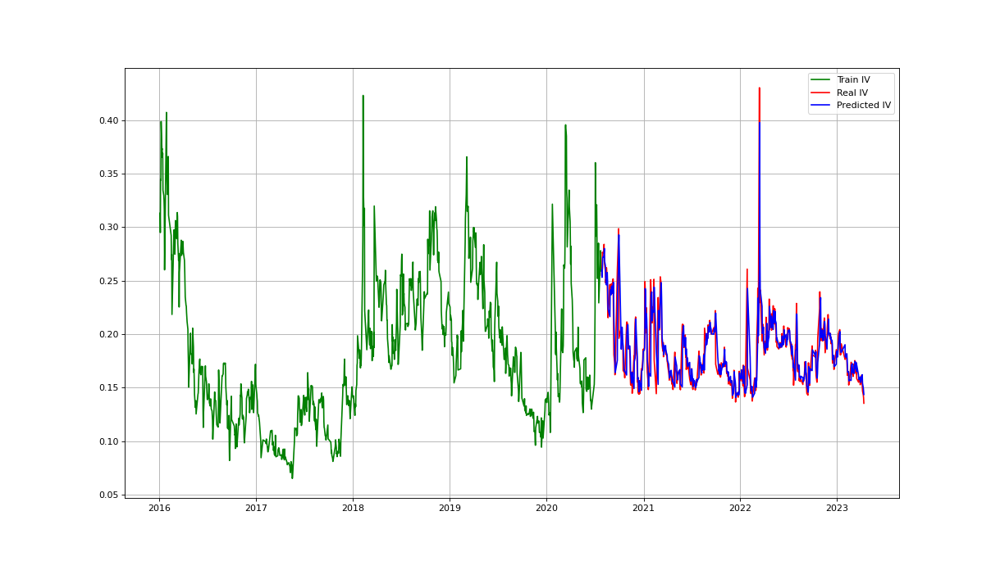

MSE: 0.0003354755826946016
MAE: 0.010035854374751477
RMSE: 0.018315992539161007


In [525]:
%matplotlib notebook
from sklearn.metrics import mean_squared_error, mean_absolute_error
from math import sqrt

arima_fit = pd.DataFrame()
arima_fit['real_test'] = test1
arima_fit['pred'] = predictions

plt.figure(figsize=(14,8))
plt.plot(train1, color='green', label = 'Train IV')
plt.plot(test1, color = 'red', label = 'Real IV')
plt.plot(arima_fit['pred'], color = 'blue', label = 'Predicted IV')
plt.legend()
plt.grid(True)
plt.show()
print('MSE: '+str(mean_squared_error(y, predictions)))
print('MAE: '+str(mean_absolute_error(y, predictions)))
print('RMSE: '+str(sqrt(mean_squared_error(y, predictions))))

### Win rate comparison

In [526]:
arima_fit['ATMVOL_due_1'] = df.iloc[-len(arima_fit):,:]['ATMVOL_due_1']
arima_fit['pred_return'] = np.log(arima_fit['pred'] / arima_fit['ATMVOL_due_1'])
arima_fit['real_return'] = np.log(arima_fit['real_test'] / arima_fit['ATMVOL_due_1'])
arima_fit['same_sign'] = arima_fit.apply(lambda x: (x['pred_return'] > 0) == (x['real_return'] > 0), axis=1)
print(f"The Win Rate based on model prediction is {arima_fit['same_sign'].sum()/len(arima_fit)}")

The Win Rate based on model prediction is 0.5160075329566854


In [508]:
arima_fit

,real_test,pred,ATMVOL_due_1,pred_return,real_return,same_sign
tradingday,,,,,,
2020-07-27,0.255104,0.259507,0.258945,0.002168,-0.014948,False
2020-07-28,0.261057,0.252966,0.255104,-0.008414,0.023068,False
2020-07-29,0.266412,0.258527,0.261057,-0.009737,0.020304,False
2020-07-30,0.276503,0.262303,0.266412,-0.015541,0.037180,False
2020-07-31,0.275201,0.271855,0.276503,-0.016953,-0.004719,True
...,...,...,...,...,...,...
2023-04-06,0.151567,0.162049,0.161652,0.002453,-0.064421,False
2023-04-07,0.146740,0.154121,0.151567,0.016711,-0.032362,False
2023-04-10,0.143034,0.149551,0.146740,0.018972,-0.025585,False


### -

### Garch Fit with Expanding Windows

In [554]:
train_garch = train1.dropna()
test_garch = test1.dropna()
history = [x for x in train_garch]
y = test_garch
predictions = list()
model = garch_model(history)
model_fit = model.fit()
yhat = model_fit.forecast(horizon=1).variance.values[-1, :]
predictions.append(yhat)
history.append(y[0])
for i in range(1, len(y)):
    model = garch_model(history)
    model_fit = model.fit()
    print(model_fit.forecast())
    yhat = model_fit.forecast(horizon=1).variance.values[-1, :]
    predictions.append(yhat)
    print(predictions)
    obs = y[i]
    history.append(obs)

Iteration:      1,   Func. Count:     70,   Neg. LLF: -306.78385282796785
Iteration:      2,   Func. Count:    139,   Neg. LLF: -276.46442991360914
Iteration:      3,   Func. Count:    210,   Neg. LLF: -178.45317784546148
Iteration:      4,   Func. Count:    280,   Neg. LLF: -297.2965468120327
Iteration:      5,   Func. Count:    350,   Neg. LLF: -307.423506368251
Iteration:      6,   Func. Count:    420,   Neg. LLF: -307.4481384972409
Iteration:      7,   Func. Count:    490,   Neg. LLF: -307.3387050032543
Iteration:      8,   Func. Count:    560,   Neg. LLF: -307.0846301061489
Iteration:      9,   Func. Count:    630,   Neg. LLF: -307.56709955567203
Iteration:     10,   Func. Count:    700,   Neg. LLF: -307.4636275059828
Iteration:     11,   Func. Count:    770,   Neg. LLF: -307.5824415756658
Iteration:     12,   Func. Count:    840,   Neg. LLF: -307.61032412799375
Iteration:     13,   Func. Count:    910,   Neg. LLF: -307.60439287837306
Iteration:     14,   Func. Count:    980,   Ne

KeyboardInterrupt: 

<IPython.core.display.Javascript object>


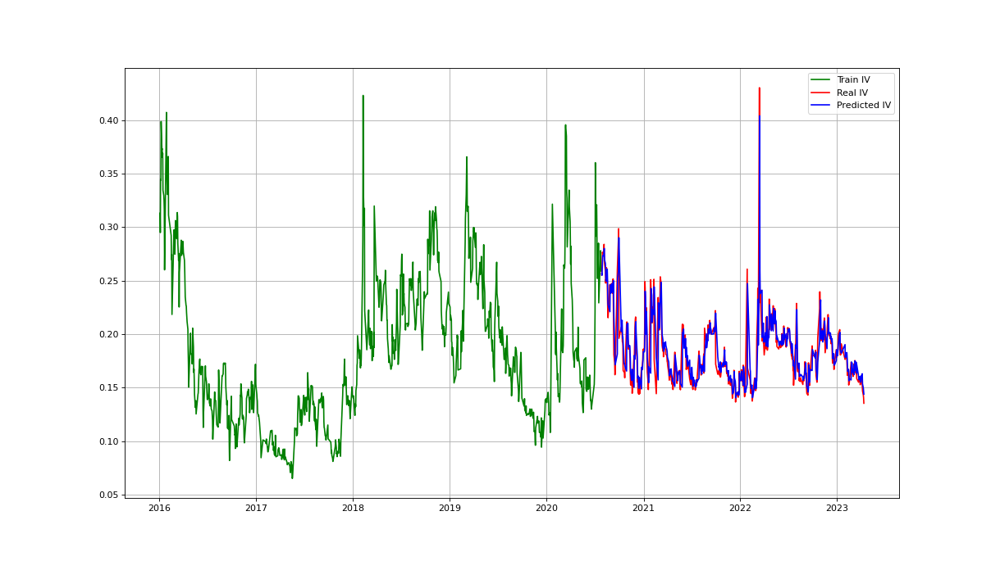

MSE: 0.022802726765126746
MAE: 0.1491817037180343
RMSE: 0.15100571765707002


In [521]:
garch_fit = pd.DataFrame()
garch_fit['real_test'] = test1
garch_fit['pred'] = np.sqrt(predictions)

plt.figure(figsize=(14,8))
plt.plot(train1, color='green', label = 'Train IV')
plt.plot(test1, color = 'red', label = 'Real IV')
plt.plot(garch_fit['pred'], color = 'blue', label = 'Predicted IV')
plt.legend()
plt.grid(True)
plt.show()
print('MSE: '+str(mean_squared_error(y, predictions)))
print('MAE: '+str(mean_absolute_error(y, predictions)))
print('RMSE: '+str(sqrt(mean_squared_error(y, predictions))))

In [523]:
garch_fit['ATMVOL_due_1'] = df.iloc[-len(arima_fit):,:]['ATMVOL_due_1']
garch_fit['pred_return'] = np.log(garch_fit['pred'] / garch_fit['ATMVOL_due_1'])
garch_fit['real_return'] = np.log(garch_fit['real_test'] / garch_fit['ATMVOL_due_1'])
garch_fit['same_sign'] = garch_fit.apply(lambda x: (x['pred_return'] > 0) == (x['real_return'] > 0), axis=1)
print(f"The Win Rate based on model prediction is {garch_fit['same_sign'].sum()/len(garch_fit)}")

The Win Rate based on model prediction is 0.5009416195856874


In [618]:
train_garch = train1.dropna()
test_garch = test1.dropna()
history = [x for x in train_garch]
y = test_garch
predictions = list()
sample_mean = list()
model = garch_model(history)
model_fit = model.fit()
yhat = model_fit.forecast(horizon=1).variance.values[-1, :]
predictions.append(yhat)
sample_mean.append(y[0])
history.append(y[0])
for i in range(1, len(y)):
    if len(history) > 7:
        history = history[-7:]
    model = garch_model(history,3,0,2)
    model_fit = model.fit()
    yhat = model_fit.forecast(horizon=1).variance.values[-1, :][0]
    predictions.append(yhat)
    sample_mean.append(sum(history)/len(history))
    print(predictions)
    obs = y[i]
    history.append(obs)

predictions[0] = predictions[0][0]

Iteration:      1,   Func. Count:     70,   Neg. LLF: -306.78385282796785
Iteration:      2,   Func. Count:    139,   Neg. LLF: -276.46442991360914
Iteration:      3,   Func. Count:    210,   Neg. LLF: -178.45317784546148
Iteration:      4,   Func. Count:    280,   Neg. LLF: -297.2965468120327
Iteration:      5,   Func. Count:    350,   Neg. LLF: -307.423506368251
Iteration:      6,   Func. Count:    420,   Neg. LLF: -307.4481384972409
Iteration:      7,   Func. Count:    490,   Neg. LLF: -307.3387050032543
Iteration:      8,   Func. Count:    560,   Neg. LLF: -307.0846301061489
Iteration:      9,   Func. Count:    630,   Neg. LLF: -307.56709955567203
Iteration:     10,   Func. Count:    700,   Neg. LLF: -307.4636275059828
Iteration:     11,   Func. Count:    770,   Neg. LLF: -307.5824415756658
Iteration:     12,   Func. Count:    840,   Neg. LLF: -307.61032412799375
Iteration:     13,   Func. Count:    910,   Neg. LLF: -307.60439287837306
Iteration:     14,   Func. Count:    980,   Ne

In [602]:
# predictions[0] = predictions[0][0]

In [619]:
import scipy.stats as stats

garch_fit = pd.DataFrame()
garch_fit['real_test'] = test1

stats_fit = pd.DataFrame()
stats_fit['sample_mean'] = sample_mean
stats_fit['sample_variance'] = predictions
n_observations = 5 


# Calculate the estimated value
confidence_level = 0.95  # Desired level of confidence
degrees_of_freedom = n_observations - 1
critical_value = stats.t.ppf((1 + confidence_level) / 2, df=degrees_of_freedom)
estimated_value = stats_fit['sample_mean'] + critical_value * np.sqrt(stats_fit['sample_variance'] / n_observations)
garch_fit['pred'] = estimated_value
garch_fit['std'] = np.sqrt(predictions)

<IPython.core.display.Javascript object>


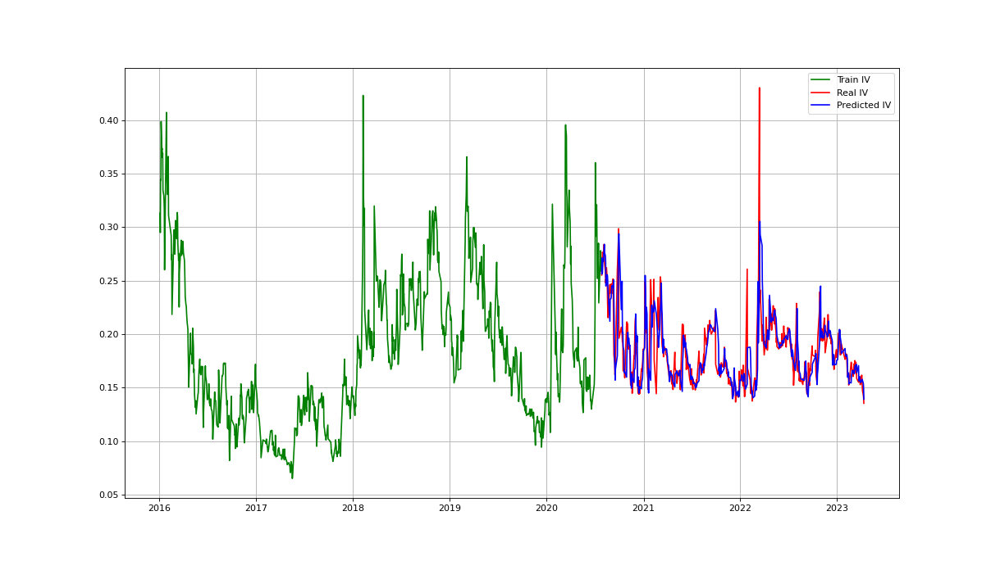

MSE: 0.0004150647932630397
MAE: 0.011849544691706687
RMSE: 0.020373139013491262


In [620]:
plt.figure(figsize=(14,8))
plt.plot(train1, color='green', label = 'Train IV')
plt.plot(test1, color = 'red', label = 'Real IV')
plt.plot(garch_fit['std'], color = 'blue', label = 'Predicted IV')
plt.legend()
plt.grid(True)
plt.show()
print('MSE: '+str(mean_squared_error(y, np.sqrt(predictions))))
print('MAE: '+str(mean_absolute_error(y, np.sqrt(predictions))))
print('RMSE: '+str(sqrt(mean_squared_error(y, np.sqrt(predictions)))))

In [621]:
garch_fit['ATMVOL_due_1'] = df.iloc[-len(arima_fit):,:]['ATMVOL_due_1']
garch_fit['pred_return'] = np.log(garch_fit['std'] / garch_fit['ATMVOL_due_1'])
garch_fit['real_return'] = np.log(garch_fit['real_test'] / garch_fit['ATMVOL_due_1'])
garch_fit['same_sign'] = garch_fit.apply(lambda x: (x['pred_return'] > 0) == (x['real_return'] > 0), axis=1)
print(f"The Win Rate based on model prediction is {garch_fit['same_sign'].sum()/len(garch_fit)}")

The Win Rate based on model prediction is 0.5404896421845574


### -

### Change Yt, should be using Return instead

In [627]:
df

,target_date,Skew_25D_due_1,Skew_25D_due_2,Skew_25D_due_3,Skew_25D_due_4,Skew_10D_due_1,Skew_10D_due_2,Skew_10D_due_3,Skew_10D_due_4,Kurtosis_25D_due_1,...,Kurtosis_10D_due_1,Kurtosis_10D_due_2,Kurtosis_10D_due_3,Kurtosis_10D_due_4,ATMVOL_due_1,ATMVOL_due_2,ATMVOL_due_3,ATMVOL_due_4,next_ATMVOL_due_1,IV_return_due_1
target_date,,,,,,,,,,,,,,,,,,,,,
2015-12-24,2015-12-24,0.946528,0.964451,0.979625,0.791004,0.956374,0.991278,0.993940,0.953796,1.053794,...,1.016445,1.005393,1.007347,0.984591,0.251388,0.274539,0.304154,0.337364,0.243904,0.970228
2015-12-25,2015-12-25,0.911996,0.975455,1.002535,0.953451,0.923177,0.983433,1.025264,0.963747,1.066176,...,1.014153,1.000190,1.023074,0.975556,0.243904,0.273826,0.296876,0.332105,0.247536,1.014890
2015-12-28,2015-12-28,0.884039,0.989217,0.977792,0.933887,0.972485,1.009575,0.994483,0.976142,1.036670,...,1.007951,1.015533,0.995923,1.011400,0.247536,0.281861,0.304278,0.328334,0.242448,0.979447
2015-12-29,2015-12-29,0.883791,0.942204,0.986722,0.897066,0.955404,0.980995,0.980241,0.966051,1.045626,...,1.012868,1.006243,0.998659,0.992049,0.242448,0.283527,0.304629,0.332374,0.247040,1.018939
2015-12-30,2015-12-30,0.884231,0.920435,0.990077,0.877654,0.951369,0.981544,1.005455,0.970209,1.046403,...,1.008643,1.008753,0.991520,0.992499,0.247040,0.282583,0.305781,0.329847,0.256422,1.037979
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-06,2023-04-06,1.022014,1.017788,0.999960,1.005222,1.023026,1.015247,1.005050,0.988009,1.002014,...,1.000944,1.007092,1.000313,0.992752,0.161652,0.167877,0.172263,0.178170,0.151567,0.937610
2023-04-07,2023-04-07,1.023743,1.036903,0.988937,1.001649,1.010624,1.013452,1.000846,0.994119,1.019071,...,1.002466,1.001801,1.006544,1.004853,0.151567,0.162653,0.169434,0.175875,0.146740,0.968156
2023-04-10,2023-04-10,1.010691,1.011729,1.000068,1.012234,1.000555,1.016480,0.992200,1.001564,1.018069,...,1.003411,1.003733,1.004768,0.999100,0.146740,0.160837,0.167362,0.174463,0.143034,0.974740


In [628]:
# split into train/test
n_test2 = int(0.3 * len(cleaned_features['IV_return_due_1']))
train2, test2 = cleaned_features['IV_return_due_1'][:-n_test], cleaned_features['IV_return_due_1'][-n_test:]

In [629]:
import pmdarima as pm

model = pm.auto_arima(
    train2, 
    start_p=0, max_p=3,
    start_q=0, max_q=3, 
    d=None,           # let model determine 'd'
    test='adf',       # using adf test to find optimal 'd'
    trace=True, error_action='ignore',  suppress_warnings=True
)

print(model.summary())

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-1829.366, Time=0.04 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-1829.155, Time=0.11 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-1829.242, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=2522.496, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-1827.410, Time=0.34 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.558 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  890
Model:                        SARIMAX   Log Likelihood                 916.683
Date:                Thu, 01 Jun 2023   AIC                          -1829.366
Time:                        18:15:49   BIC                          -1819.783
Sample:                             0   HQIC                         -1825.703
                                - 890                                   

In [631]:
train_garch = train2.dropna()
test_garch = test2.dropna()
history = [x for x in train_garch]
y = test_garch
predictions = list()
model = garch_model(history)
model_fit = model.fit()
yhat = model_fit.forecast(horizon=1).variance.values[-1, :]
predictions.append(yhat)
history.append(y[0])
for i in range(1, len(y)):
    if len(history) > 5:
        history = history[-5:]
    model = garch_model(history,1,0,1)
    model_fit = model.fit()
    yhat = model_fit.forecast(horizon=1).variance.values[-1, :][0]
    predictions.append(yhat)
    obs = y[i]
    history.append(obs)

predictions[0] = predictions[0][0]

Iteration:      1,   Func. Count:     70,   Neg. LLF: 1893.1669149104564
Iteration:      2,   Func. Count:    143,   Neg. LLF: 1264.2313499391223
Iteration:      3,   Func. Count:    213,   Neg. LLF: 1261.2511134416811
Iteration:      4,   Func. Count:    283,   Neg. LLF: 1260.347717964989
Iteration:      5,   Func. Count:    353,   Neg. LLF: 1260.2329751542495
Iteration:      6,   Func. Count:    423,   Neg. LLF: 1260.0149981507664
Iteration:      7,   Func. Count:    493,   Neg. LLF: 1259.8947374495585
Iteration:      8,   Func. Count:    562,   Neg. LLF: 1259.9491978043866
Iteration:      9,   Func. Count:    632,   Neg. LLF: 1259.9697455891262
Iteration:     10,   Func. Count:    702,   Neg. LLF: 1259.9659244372276
Iteration:     11,   Func. Count:    772,   Neg. LLF: 1259.936003778158
Iteration:     12,   Func. Count:    842,   Neg. LLF: 1259.8816071701535
Iteration:     13,   Func. Count:    912,   Neg. LLF: 1259.864193492301
Iteration:     14,   Func. Count:    982,   Neg. LLF: 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [638]:
import scipy.stats as stats

garch_fit = pd.DataFrame()
garch_fit['real_test'] = test2
garch_fit['std'] = np.sqrt(predictions)

<IPython.core.display.Javascript object>


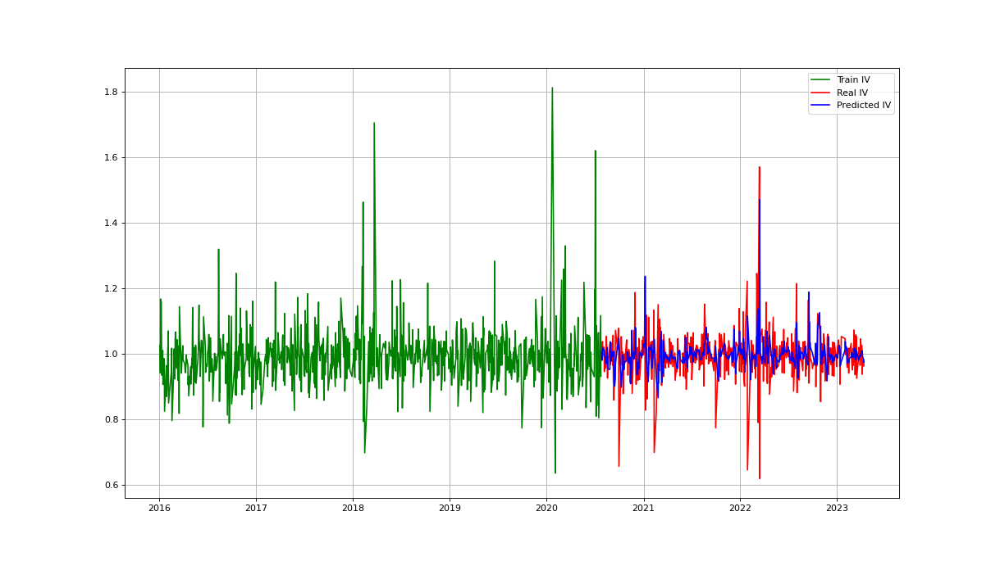

MSE: 0.007362906923442751
MAE: 0.05244289670470369
RMSE: 0.08580738268612294


In [633]:
plt.figure(figsize=(14,8))
plt.plot(train2, color='green', label = 'Train IV')
plt.plot(test2, color = 'red', label = 'Real IV')
plt.plot(garch_fit['std'], color = 'blue', label = 'Predicted IV')
plt.legend()
plt.grid(True)
plt.show()
print('MSE: '+str(mean_squared_error(test2, np.sqrt(predictions))))
print('MAE: '+str(mean_absolute_error(test2, np.sqrt(predictions))))
print('RMSE: '+str(sqrt(mean_squared_error(test2, np.sqrt(predictions)))))

In [639]:
garch_fit

,real_test,std
tradingday,,
2020-07-27,0.985163,1.002031
2020-07-28,1.023337,0.980242
2020-07-29,1.020512,1.008533
2020-07-30,1.037880,1.008745
2020-07-31,0.995292,1.017540
...,...,...
2023-04-06,0.937610,1.009728
2023-04-07,0.968156,0.992493
2023-04-10,0.974740,0.985482


In [643]:
garch_fit['same_sign'] = garch_fit.apply(lambda x: (x['real_test'] > 1) == (x['std'] > 1), axis=1)
print(f"The Win Rate based on model prediction is {garch_fit['same_sign'].sum()/len(garch_fit)}")

The Win Rate based on model prediction is 0.4934086629001883


In [702]:
def returns_predict(period):
    returns_pool = []
    for i in range(period):
        sigma_t = res.conditional_volatility.iloc[-1]
        print(sigma_t)
        epsilon_t = sigma_t * np.random.standard_normal()
        sigma_forecast = np.sqrt(omega + alpha * epsilon_t ** 2 + beta * sigma_t ** 2)
        epsilon_forecast = sigma_forecast * np.random.standard_normal()
        returns_forecast = mu + epsilon_forecast + theta * epsilon_t
        returns_pool.append(returns_forecast)
        sigma_t = sigma_forecast
    return returns_pool

In [703]:
from statsmodels.tsa.arima.model import ARIMA
from arch.univariate import ZeroMean, GARCH, StudentsT, ConstantMean
arma_mod01 = ARIMA(train2, None,(1,0,1)).fit()
arch_mod = ConstantMean(train2)
arch_mod.volatility = GARCH(1,0,1)
arch_mod.distribution = StudentsT()
res=arch_mod.fit(update_freq=5, disp='off')
print(res)
print(res.conditional_volatility)
mu = arma_mod01.params[0]
theta = arma_mod01.params[1]
omega = res.params[1]
alpha = res.params[2]
beta = res.params[3]

                        Constant Mean - GARCH Model Results                         
Dep. Variable:              IV_return_due_1   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                            GARCH   Log-Likelihood:                1093.35
Distribution:      Standardized Student's t   AIC:                          -2176.69
Method:                  Maximum Likelihood   BIC:                          -2152.74
                                              No. Observations:                  890
Date:                      Thu, Jun 01 2023   Df Residuals:                      889
Time:                              19:03:29   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0

In [704]:
returns_predict(1)

0.11292327279272033


[1.1200375483885867]

In [661]:
garch_fit = pd.DataFrame()
garch_fit['real_test'] = test2
garch_fit['pred'] =returns_predict(n_test)

<IPython.core.display.Javascript object>


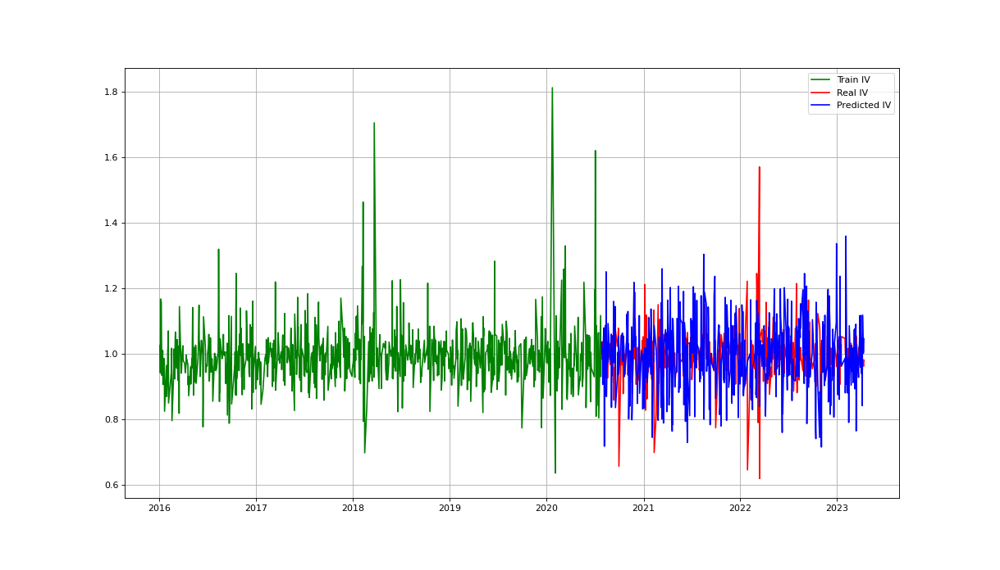

MSE: 0.016116549181760417
MAE: 0.10392180894502828
RMSE: 0.13385059788256262


In [662]:
plt.figure(figsize=(14,8))
plt.plot(train2, color='green', label = 'Train IV')
plt.plot(test2, color = 'red', label = 'Real IV')
plt.plot(garch_fit['pred'], color = 'blue', label = 'Predicted IV')
plt.legend()
plt.grid(True)
plt.show()
print('MSE: '+str(mean_squared_error(test2, returns_predict(n_test))))
print('MAE: '+str(mean_absolute_error(test2, returns_predict(n_test))))
print('RMSE: '+str(sqrt(mean_squared_error(test2,returns_predict(n_test)))))

In [667]:
garch_fit['same_sign'] = garch_fit.apply(lambda x: (x['real_test'] > 1) == (x['pred'] > 1), axis=1)
print(f"The Win Rate based on model prediction is {garch_fit['same_sign'].sum()/len(garch_fit)}")

The Win Rate based on model prediction is 0.4839924670433145


In [672]:
print(f"The Win Rate based on model prediction is {garch_fit['same_sign'][:10].sum()/10}")

The Win Rate based on model prediction is 0.7


In [720]:
def returns_predict(period):
    returns_pool = []
    for i in range(period):
        sigma_t = res.conditional_volatility[-1]
        print(sigma_t)
        epsilon_t = sigma_t * np.random.standard_normal()
        sigma_forecast = np.sqrt(omega + alpha * epsilon_t ** 2 + beta * sigma_t ** 2)
        epsilon_forecast = sigma_forecast * np.random.standard_normal()
        returns_forecast = mu + epsilon_forecast + theta * epsilon_t
        returns_pool.append(returns_forecast)
        sigma_t = sigma_forecast
    return returns_pool



train_garch = train2.dropna()
test_garch = test2.dropna()

history = [x for x in train_garch]
y = test_garch
predictions = list()

arma_mod01 = ARIMA(train2, None,(1,0,1)).fit()
arch_mod = ConstantMean(train2)
arch_mod.volatility = GARCH(1,0,1)
arch_mod.distribution = StudentsT()
res=arch_mod.fit(update_freq=0, disp='off')
mu = arma_mod01.params[0]
theta = arma_mod01.params[1]
omega = res.params[1]
alpha = res.params[2]
beta = res.params[3]
yhat = returns_predict(1)
print(yhat)
predictions.append(yhat)
history.append(y[0])
print(history)


for i in range(1, len(y)):
#     if len(history) > 5:
#         history = history[-5:]
    arma_mod01 = ARIMA(history, None,(1,0,1)).fit()
    arch_mod = ConstantMean(history)
    arch_mod.volatility = GARCH(1,0,1)
    arch_mod.distribution = StudentsT()
    res=arch_mod.fit(update_freq=0, disp='off')
    mu = arma_mod01.params[0]
    theta = arma_mod01.params[1]
    omega = res.params[1]
    alpha = res.params[2]
    beta = res.params[3]
    yhat = returns_predict(5)

    predictions.append(yhat[0])
    obs = y[i]
    history.append(obs)

predictions[0] = predictions[0][0]

0.11292327279272033
[1.0011567213861516]
[1.0258180316393248, 0.9420188552669913, 1.1677009614083254, 0.9981729967877444, 1.1599004227375669, 0.9344025161104836, 1.0021546905319827, 0.9779222619246958, 1.0106530413765136, 0.906537730344372, 0.985688033967706, 0.9862299686895476, 0.9697613225465662, 0.8247007330628049, 0.9646125325830874, 0.8697662625489246, 0.93316354151541, 1.0093700133041272, 1.0252347064252267, 1.0703117102987123, 0.8499388275744773, 0.9391462446028772, 0.923211260476714, 1.017253554891287, 0.7958470227834773, 0.9582894085161991, 1.0149459986142555, 0.9235053125949172, 1.0444760715453625, 1.0669055920535122, 0.9831524507888156, 1.004722647085277, 0.9562721689406782, 1.0440696802259788, 1.0386449009421184, 0.9881889553512304, 0.9195264146112284, 0.9429708464390408, 1.024614043896409, 0.8183644720779798, 1.1447294222807984, 0.9411756852140124, 0.9506343811955146, 1.0083537731554468, 1.0136520299484495, 1.0252086346851823, 0.9857554192735216, 0.978430066670138, 0.97289

In [717]:
garch_fit = pd.DataFrame()
garch_fit['real_test'] = test2
garch_fit['pred'] =predictions

<IPython.core.display.Javascript object>


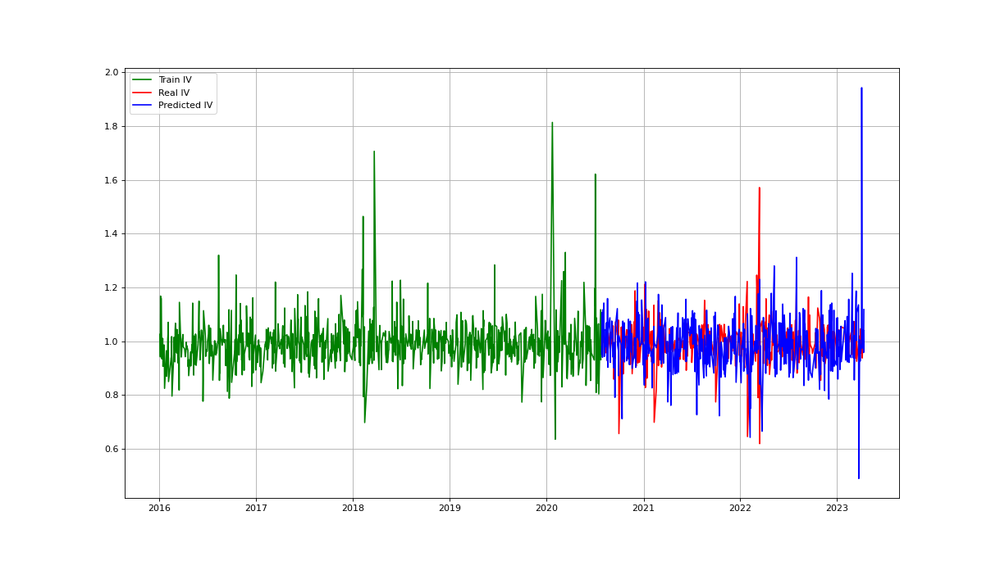

MSE: 0.014168911423283252
MAE: 0.08320331169110211
RMSE: 0.11903323663281298


In [718]:
plt.figure(figsize=(14,8))
plt.plot(train2, color='green', label = 'Train IV')
plt.plot(test2, color = 'red', label = 'Real IV')
plt.plot(garch_fit['pred'], color = 'blue', label = 'Predicted IV')
plt.legend()
plt.grid(True)
plt.show()
print('MSE: '+str(mean_squared_error(test2, predictions)))
print('MAE: '+str(mean_absolute_error(test2, predictions)))
print('RMSE: '+str(sqrt(mean_squared_error(test2,predictions))))

In [719]:
garch_fit['same_sign'] = garch_fit.apply(lambda x: (x['real_test'] > 1) == (x['pred'] > 1), axis=1)
print(f"The Win Rate based on model prediction is {garch_fit['same_sign'].sum()/len(garch_fit)}")

The Win Rate based on model prediction is 0.5216572504708098


In [714]:
garch_fit

,real_test,pred,same_sign
tradingday,,,
2020-07-27,0.985163,0.916657,True
2020-07-28,1.023337,0.996683,False
2020-07-29,1.020512,1.072202,True
2020-07-30,1.037880,1.103222,True
2020-07-31,0.995292,0.951274,True
...,...,...,...
2023-04-06,0.937610,1.019932,False
2023-04-07,0.968156,1.053318,False
2023-04-10,0.974740,0.934747,True
